In [6]:
import numpy as np
import pandas as pd
from matplotlib import pyplot as plt
from matplotlib.lines import Line2D
import matplotlib.ticker as mtick
plt.style.use('ggplot')
import seaborn as sns
import plotly.express as px
pd.options.display.float_format = '{:,.0f}'.format
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
import dataframe_image as dfi
from pandas.api.types import CategoricalDtype
from matplotlib.ticker import MultipleLocator, FuncFormatter
from scipy.stats import linregress
import warnings
warnings.simplefilter(action='ignore', category=pd.errors.SettingWithCopyWarning)

In [2]:
Accepted_Only = pd.read_csv('Accepted_Only.csv')
Accepted_Only['Repayment_Rate'] = np.where(Accepted_Only['Loan_Status'] == 'Fully Paid', 100, 0)

In [3]:
#Set order for Employment Length in Accepted_Only
emp_length_order = ['< 1 year', '1 year', '2 years', '3 years', '4 years', '5 years', '6 years', '7 years', '8 years', '9 years', '10+ years']
cat_type = CategoricalDtype(categories=emp_length_order, ordered=True)

Accepted_Only['Employment_Length'] = Accepted_Only['Employment_Length'].astype(cat_type)

In [4]:
#Single Year Copy
Accepted_Only_2017 = Accepted_Only[Accepted_Only['Year'] == 2017]

#Paid vs Charged Off Copies
Accepted_Only_Paid = Accepted_Only[Accepted_Only['Loan_Status'] == 'Fully Paid']
Accepted_Only_ChargedOff = Accepted_Only[Accepted_Only['Loan_Status'] == 'Charged Off']
Accepted_Only_ChargedOff['Percent_Paid'] = (Accepted_Only_ChargedOff['Principal_Received'] / Accepted_Only_ChargedOff['Funded_Amount']) * 100

In [23]:
Accepted_Only_Ord = pd.read_csv('Accepted_Only_OrdEncoded.csv')
Accepted_Only_Ord_Numeric_only = Accepted_Only_Ord[['Loan_Status', 'ROI_funded_amount', 'Term', 'Grade', 'Risk_Score', 'Employment_Length', 'Income_Verification_Status', 'Debt-Income', 'Loan-Income', 'Int_Rate', 'Mortgage_Accounts', 'Bankruptcies', 'Year']]

In [20]:
Accepted_Only_Bankruptcy = Accepted_Only
legend = pd.DataFrame({
    'Value': [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12],
    'Value_Order': ['0', '1+', '1+', '1+', '1+', '1+', '1+', '1+', '1+', '1+', '1+', '1+', '1+']})
mapping = dict(zip(legend['Value'], legend['Value_Order']))
Accepted_Only_Bankruptcy['Bankruptcies'] = Accepted_Only_Bankruptcy['Bankruptcies'].map(mapping)

In [8]:
print('Min DTI:', Accepted_Only['Debt-Income'].min())
print('Max DTI:', Accepted_Only['Debt-Income'].max())
print(Accepted_Only['Debt-Income'].value_counts(dropna=False).sort_index())

Min DTI: 0.0
Max DTI: 999.0
Debt-Income
0      774
0       11
0       22
0       10
0        9
0       10
0       23
0       20
0       19
0       15
0       18
0       20
0       21
0       31
0       22
0       22
0       30
0       26
0       24
0       20
0       52
0       33
0       33
0       28
0       39
0       55
0       48
0       36
0       39
0       42
0       55
0       50
0       47
0       65
0       30
0       41
0       52
0       35
0       71
0       40
0       59
0       44
0       49
0       60
0       62
0       73
0       60
0       35
0       72
0       33
0      104
1       35
1       68
1       68
1       65
1       71
1       62
1       66
1       75
1       55
1      110
1       65
1       58
1       60
1       52
1       61
1       49
1       83
1       54
1       61
1       76
1       82
1       78
1       38
1       63
1       99
1       47
1       61
1       67
1       65
1       78
1       78
1       72
1       74
1       72
1       49
1      101
1  

In [9]:
def barplot_Paid_Unpaid(col='Late_Fees', status_col='Loan_Status', df=Accepted_Only):
    df = df.copy()
    df[col] = pd.to_numeric(df[col], errors='coerce')
    summary = df.groupby(status_col, observed=False)[col].mean().reset_index()

    sns.set_style('whitegrid')
    plt.figure(figsize=(8, 6), dpi=300)
    sns.barplot(data=summary, x=status_col, y=col, hue=status_col, palette=['red', 'blue'])

    for i, v in enumerate(summary[col]):
        plt.text(i, v + (v * 0.02 if v > 0 else 0.02), f"{v:.2f}", 
                 ha='center', va='bottom', fontweight='bold')

    plt.title(f'Average {col}: Fully Paid vs Charged Off', fontsize=14, fontweight='bold')
    plt.xlabel('Loan Status', fontsize=12)
    plt.ylabel(f'Average {col}', fontsize=12)
    plt.tight_layout()
    plt.show()

In [10]:
#Define 1x3 Histogram function
def custom_kde_subplots_1x3(frame_name, col1, col2, col3, x_format='number'):
    sns.set_style('whitegrid')
    cols = [col1, col2, col3]

    fig, axes = plt.subplots(1, 3, figsize=(18, 6))
    axes = axes.flatten()

    for i, col in enumerate(cols):
        ax = axes[i]

        if col not in frame_name.columns:
            ax.text(0.5, 0.5, f"'{col}' not found", ha='center', va='center', fontsize=12)
            ax.axis('off')
            continue

        data = frame_name[col].dropna()
        if data.empty:
            ax.text(0.5, 0.5, 'No Data', ha='center', va='center', fontsize=12)
            ax.axis('off')
            continue

        mean_col = data.mean()
        median_col = data.median()
        mode_col = data.mode().iloc[0] if not data.mode().empty else None
        skew_col = data.skew()
        kurt_col = data.kurt()

        sns.histplot(data, bins=100, kde=True, color='skyblue', ax=ax)

        ax.axvline(mean_col, color='r', linestyle='--', label=f'Mean: {mean_col:,.0f}')
        ax.axvline(median_col, color='g', linestyle='-', label=f'Median: {median_col:,.0f}')
        if mode_col is not None:
            ax.axvline(mode_col, color='b', linestyle='-.', label=f'Mode: {mode_col:,.0f}')

        ax.annotate(
            f'Skewness: {skew_col:.2f}\nKurtosis: {kurt_col:.2f}',
            xy=(0.98, 0.95), xycoords='axes fraction',
            fontsize=10, ha='right', va='top',
            bbox=dict(boxstyle='round,pad=0.3', edgecolor='black', facecolor='skyblue')
        )

        ax.set_title(col, fontsize=13)
        ax.legend(fontsize=9)
        ax.set_xlabel('')
        ax.set_ylabel('Frequency')

        ax.yaxis.set_major_formatter(mtick.FuncFormatter(lambda y, _: f'{y:,.0f}'))
        if x_format == 'percent':
            ax.xaxis.set_major_formatter(mtick.FuncFormatter(lambda x, _: f'{x:.0f}%'))
        else:
            ax.xaxis.set_major_formatter(mtick.FuncFormatter(lambda x, _: f'{x:,.0f}'))

    plt.tight_layout()
    plt.show()

In [11]:
def custom_kde_subplots_2x2(frame_name, col1, col2=None, col3=None, col4=None, x_format='number'):
    sns.set_style('whitegrid')
    cols = [c for c in [col1, col2, col3, col4] if c is not None]

    fig, axes = plt.subplots(2, 2, figsize=(18, 10))
    axes = axes.flatten()

    for i, col in enumerate(cols):
        ax = axes[i]
        data = frame_name[col].dropna()

        if data.empty:
            ax.text(0.5, 0.5, 'No Data', ha='center', va='center', fontsize=12)
            ax.set_title(col, fontsize=13)
            ax.axis('off')
            continue

        mean_col = data.mean()
        median_col = data.median()
        mode_col = data.mode().iloc[0] if not data.mode().empty else None
        skew_col = data.skew()
        kurt_col = data.kurt()

        sns.histplot(data, bins=100, kde=True, color='skyblue', ax=ax)

        ax.axvline(mean_col, color='r', linestyle='--', label=f'Mean: {mean_col:,.0f}')
        ax.axvline(median_col, color='g', linestyle='-', label=f'Median: {median_col:,.0f}')
        if mode_col is not None:
            ax.axvline(mode_col, color='b', linestyle='-.', label=f'Mode: {mode_col:,.0f}')

        ax.annotate(
            f'Skewness: {skew_col:.2f}\nKurtosis: {kurt_col:.2f}',
            xy=(0.98, 0.95), xycoords='axes fraction',
            fontsize=10, ha='right', va='top',
            bbox=dict(boxstyle='round,pad=0.3', edgecolor='black', facecolor='aliceblue')
        )

        ax.set_title(col, fontsize=13)
        ax.legend(fontsize=9)
        ax.set_xlabel('')
        ax.set_ylabel('Frequency')

        ax.yaxis.set_major_formatter(mtick.FuncFormatter(lambda y, _: f'{y:,.0f}'))
        if x_format == 'percent':
            ax.xaxis.set_major_formatter(mtick.FuncFormatter(lambda x, _: f'{x:.0f}%'))
        else:
            ax.xaxis.set_major_formatter(mtick.FuncFormatter(lambda x, _: f'{x:,.0f}'))

    for j in range(len(cols), len(axes)):
        axes[j].axis('off')

    plt.tight_layout()
    plt.show()

In [10]:
def custom_kde(frame_name, col_name, xlimit=None, nbins = 1000):
    sns.set_style('whitegrid')

    data = frame_name[col_name]

    mean_col = data.mean()
    median_col = data.median()
    mode_col = data.mode().values[0]

    plt.figure(figsize=(14, 7))

    sns.histplot(x=data, bins=nbins, kde=True, color='skyblue')

    plt.axvline(mean_col, color='r', linestyle='--', label=f'Mean: {mean_col:,.0f}')
    plt.axvline(median_col, color='g', linestyle='-', label=f'Median: {median_col:,.0f}')
    plt.axvline(mode_col, color='b', linestyle='-.', label=f'Mode: {mode_col:,.0f}')

    ax = plt.gca()
    ymax = ax.get_ylim()[1]
    xpos = ax.get_xlim()[1] * 0.70
    ypos = ymax * 0.85

    plt.annotate(
        f'Skewness: {data.skew():.2f}\nKurtosis: {data.kurt():.2f}',
        xy=(xpos, ypos),
        fontsize=14,
        bbox=dict(boxstyle='round,pad=0.3', edgecolor='black', facecolor='skyblue')
    )

    plt.title(col_name)
    plt.legend()
    plt.xlabel(col_name)
    plt.ylabel('Frequency')

    ax.xaxis.set_major_formatter(lambda x, pos: f'{x:,.0f}')
    ax.yaxis.set_major_formatter(lambda y, pos: f'{y:,.0f}')

    if xlimit is not None:
        plt.xlim(0, xlimit)

    plt.show()

In [13]:
#Layered Density Function Definition: Fully Paid vs Charged Off
def stacked_density_status(col, paidclip=0, chargedoffclip=-100, tickspace=10):
    
    sns.set_style('whitegrid')
    plt.figure(figsize=(12, 6), dpi=300)
    
    # Fully Paid KDE
    sns.kdeplot(
        data=Accepted_Only[Accepted_Only['Loan_Status'] == 'Fully Paid'],
        x=col,
        fill=True,
        label='Fully Paid',
        color='green',
        alpha=0.6,
        bw_adjust=.3,
        clip=(paidclip, None)
    )
    
    sns.kdeplot(
        data=Accepted_Only[Accepted_Only['Loan_Status'] == 'Charged Off'],
        x=col,
        fill=True,
        label='Charged Off',
        color='red',
        alpha=0.6,
        bw_adjust=.3,
        clip=(chargedoffclip, None)
    )
    
    plt.title(f'Stacked Density of {col} by Loan Status', fontsize=18, pad=20)
    plt.xlabel(col, fontsize=15)
    plt.ylabel('Density', fontsize=15)
    plt.legend(title='')
    plt.gca().xaxis.set_major_locator(MultipleLocator(tickspace))
    plt.gca().xaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: f'{int(x)}%'))
    plt.tight_layout()
    plt.show()

In [14]:
#Layered Histogram Function Definition: Fully Paid vs Charged Off
def stacked_hist_status(col, tickspace=10, bins=500):
    
    sns.set_style('whitegrid')
    plt.figure(figsize=(12, 6), dpi=300)
    
    sns.histplot(
        data=Accepted_Only,
        x=col,
        hue='Loan_Status',
        multiple='layer',
        bins=bins,
        palette={'Fully Paid': 'green', 'Charged Off': 'red'},
        alpha=0.5,
        edgecolor=None,
        legend=False
    )
    
    #Stats
    paid = Accepted_Only[Accepted_Only['Loan_Status'] == 'Fully Paid'][col]
    charged = Accepted_Only[Accepted_Only['Loan_Status'] == 'Charged Off'][col]
    
    stats = {
        'Fully Paid': {
            'color': 'green',
            'mean': paid.mean(),
            'min': paid.min(),
            'max': paid.max(),
            'count': paid.count(),
            'ha': 'right',
            'xpos': plt.gca().get_xlim()[1]
        },
        'Charged Off': {
            'color': 'red',
            'mean': charged.mean(),
            'min': charged.min(),
            'max': charged.max(),
            'count': charged.count(),
            'ha': 'left',
            'xpos': plt.gca().get_xlim()[0]
        }
    }
    
    ymax = plt.gca().get_ylim()[1]
    
    for status, s in stats.items():
        color = s['color']
        
        #Vertical lines
        plt.axvline(s['min'], color=color, linestyle=':', linewidth=1.5)
        plt.axvline(s['mean'], color=color, linestyle='--', linewidth=2)
        plt.axvline(s['max'], color=color, linestyle=':', linewidth=1.5)
        
        #Summary text box
        plt.text(
            s['xpos'], ymax * 0.95,
            f"{status}\n"
            f"Mean: {s['mean']:.0f}%\n"
            f"Min: {s['min']:.0f}%\n"
            f"Max: {s['max']:.0f}%\n"
            f"Count: {s['count']:,}",
            color=color, ha=s['ha'], va='top', fontsize=11, fontweight='bold',
            bbox=dict(facecolor='white', alpha=0.7, edgecolor=color)
        )
    
    plt.title(f'Histogram of {col} by Loan Status', fontsize=18, pad=20)
    plt.xlabel(col, fontsize=15)
    plt.ylabel('Count', fontsize=15)
    plt.gca().xaxis.set_major_locator(MultipleLocator(tickspace))
    plt.gca().xaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: f'{int(x)}%'))
    plt.gca().yaxis.set_major_formatter(mtick.FuncFormatter(lambda x, _: f'{int(x):,}'))
    plt.tight_layout()
    plt.show()

In [15]:
#Define Annual Line Plot
def annual_trend_plot(col1, col2, col1_color = 'blue', col2_color = 'purple', df = Accepted_Only, y_format='number', year_col='Year', ylabel=''):
    df_grouped = df.groupby(year_col)[[col1, col2]].mean().reset_index()

    sns.set_style('whitegrid')
    plt.figure(figsize=(12, 6), dpi=300)

    plt.plot(df_grouped[year_col], df_grouped[col1],
             marker='o', label= col1, color=col1_color, linewidth=2)
    plt.plot(df_grouped[year_col], df_grouped[col2],
             marker='o', label=col2, color=col2_color, linewidth=2)

    plt.title(f'Annual Trend: {col1} vs {col2}', fontsize=18, pad=15)
    plt.xlabel('Year', fontsize=15)
    plt.ylabel(ylabel, fontsize=15)
    plt.xticks(df_grouped[year_col], rotation=0)
    
    if y_format == 'percent':
        plt.gca().yaxis.set_major_formatter(mtick.FuncFormatter(lambda y, _: f'{y:.0f}%'))
    else:
        plt.gca().yaxis.set_major_formatter(mtick.FuncFormatter(lambda y, _: f'{y:,.0f}'))

    plt.legend(title='', fontsize=11, loc='best')
    plt.tight_layout()
    plt.show()

In [16]:
def custom_bar_subplots_2x2(frame_name, col1, col2=None, col3=None, col4=None):
    sns.set_style('whitegrid')
    cols = [c for c in [col1, col2, col3, col4] if c is not None]

    fig, axes = plt.subplots(2, 2, figsize=(18, 10))
    axes = axes.flatten()

    for i, col in enumerate(cols):
        ax = axes[i]

        if col not in frame_name.columns:
            ax.text(0.5, 0.5, 'Column Not Found', ha='center', va='center', fontsize=12)
            ax.set_title(col, fontsize=13)
            ax.axis('off')
            continue

        data = frame_name[col].dropna()
        if data.empty:
            ax.text(0.5, 0.5, 'No Data', ha='center', va='center', fontsize=12)
            ax.set_title(col, fontsize=13)
            ax.axis('off')
            continue

        counts = data.value_counts().sort_index()

        sns.barplot(
            x=list(range(len(counts))),
            y=counts.values,
            color='blue',
            ax=ax
        )

        mean_val = counts.values.mean()
        ax.axhline(mean_val, color='r', linestyle='--', label=f'Mean Count: {mean_val:,.0f}')
        ax.legend(fontsize=9)

        # Set title and labels
        ax.set_title(col, fontsize=13)
        ax.set_xlabel('')
        ax.set_ylabel('Count')

        # Replace numeric x-ticks with category labels
        ax.set_xticks(list(range(len(counts))))
        ax.set_xticklabels(counts.index, rotation=45)

        # Format y-axis
        ax.yaxis.set_major_formatter(mtick.FuncFormatter(lambda y, _: f'{y:,.0f}'))

    #Hide unused subplots
    for j in range(len(cols), len(axes)):
        axes[j].axis('off')

    plt.tight_layout()
    plt.show()

In [14]:
def Repayment_ROI_scatter_plot_reg(x_col, x_format='number', rot=0, df=Accepted_Only):
    col1 = 'Repayment_Rate'
    col2 = 'ROI_funded_amount'
    col1_color = 'blue'
    col2_color = 'purple'
    df = df.copy()

    #Grouped dataset
    df_grouped = (
        df.groupby(x_col, observed=False)[[col1, col2]]
        .mean()
        .reset_index()
        .sort_values(by=x_col)
    )

    sns.set_style('whitegrid')
    plt.figure(figsize=(12, 6), dpi=300)

    #Scatter Points
    plt.scatter(df_grouped[x_col], df_grouped[col1], s=80, color=col1_color, label='Repayment Rate', alpha=0.8)
    plt.scatter(df_grouped[x_col], df_grouped[col2], s=80, color=col2_color, label='ROI', alpha=0.8)

    #Regression lines
    if pd.api.types.is_numeric_dtype(df_grouped[x_col]):
        for col, color, label in [(col1, col1_color, 'Repayment'), (col2, col2_color, 'ROI')]:
            slope, intercept, r, p, _ = linregress(df_grouped[x_col], df_grouped[col])
            plt.plot(
                df_grouped[x_col],
                intercept + slope * df_grouped[x_col],
                linestyle='--',
                color=color,
                label=f'{label} Trend'
            )

    plt.title(f'Repayment Rate and ROI by {x_col}', fontsize=18, pad=15)
    plt.xlabel(x_col, fontsize=15)
    plt.ylabel('Value (%)', fontsize=15)
    plt.xticks(rotation=rot, ha='right')

    plt.legend(title='', fontsize=10, loc='best')
    plt.gca().yaxis.set_major_formatter(mtick.FuncFormatter(lambda y, _: f'{y:.0f}%'))

    if x_format == 'percent' and pd.api.types.is_numeric_dtype(df_grouped[x_col]):
        plt.gca().xaxis.set_major_formatter(mtick.FuncFormatter(lambda x, _: f'{x:.0f}%'))
    elif x_format == 'number' and pd.api.types.is_numeric_dtype(df_grouped[x_col]):
        plt.gca().xaxis.set_major_formatter(mtick.FuncFormatter(lambda x, _: f'{x:,.0f}'))

    plt.tight_layout()
    plt.show()

In [18]:
def ROI_scatter_plot_reg(x_col, x_format='number', rot=0, df=Accepted_Only_ChargedOff):
    col2 = 'ROI_funded_amount'
    col2_color = 'purple'

    df = df.copy()

    sns.set_style('whitegrid')
    plt.figure(figsize=(12, 6), dpi=300)

    plt.scatter(df[x_col], df[col2], s=30, color=col2_color, alpha=0.5, label='ROI')

    #Add regression lines (no grouping)
    if pd.api.types.is_numeric_dtype(df[x_col]):
        slope, intercept, r, p, _ = linregress(df[x_col], df[col2])
        x_vals = np.linspace(df[x_col].min(), df[x_col].max(), 200)
        y_vals = intercept + slope * x_vals
        plt.plot(x_vals, y_vals, linestyle='--', color=col2_color,
                 label=f'ROI Trend (R²={r**2:.2f})')

    plt.title(f'ROI by {x_col}', fontsize=18, pad=15)
    plt.xlabel(x_col, fontsize=15)
    plt.ylabel('Value (%)', fontsize=15)
    plt.xticks(rotation=rot, ha='right')
    plt.legend(title='', fontsize=10, loc='best')

    plt.gca().yaxis.set_major_formatter(mtick.PercentFormatter())
    if x_format == 'percent' and pd.api.types.is_numeric_dtype(df[x_col]):
        plt.gca().xaxis.set_major_formatter(mtick.PercentFormatter())
    elif x_format == 'number' and pd.api.types.is_numeric_dtype(df[x_col]):
        plt.gca().xaxis.set_major_formatter(mtick.FuncFormatter(lambda x, _: f'{x:,.0f}'))

    plt.tight_layout()
    plt.show()

In [19]:
def Repayment_ROI_trend_plot(x_col, x_format='number', rot=0, df=Accepted_Only, order=None):
    col1 = 'Repayment_Rate'
    col2 = 'ROI_funded_amount'
    col1_color = 'blue'
    col2_color = 'purple'

    df = df.copy()

    #Apply specified order for categorical variable
    if order is not None:
        cat_type = CategoricalDtype(categories=order, ordered=True)
        df[x_col] = df[x_col].astype(cat_type)
        df_grouped = df.groupby(x_col, observed=False)[[col1, col2]].mean().reset_index()
    else:
        df_grouped = df.groupby(x_col, observed=False)[[col1, col2]].mean().reset_index().sort_values(by=x_col)

    sns.set_style('whitegrid')
    plt.figure(figsize=(12, 6), dpi=300)
    
    plt.plot(df_grouped[x_col], df_grouped[col1],
             marker='o', label='Repayment Rate', color=col1_color, linewidth=2)
    plt.plot(df_grouped[x_col], df_grouped[col2],
             marker='o', label='ROI', color=col2_color, linewidth=2)

    plt.title(f'Repayment Rate and ROI by {x_col}', fontsize=18, pad=15)
    plt.xlabel(x_col, fontsize=15)
    plt.ylabel('Value (%)', fontsize=15)
    plt.xticks(rotation=rot, ha='right')

    plt.legend(title='', fontsize=11, loc='upper right')
    plt.gca().yaxis.set_major_formatter(mtick.FuncFormatter(lambda y, _: f'{y:.0f}%'))

    if x_format == 'percent' and pd.api.types.is_numeric_dtype(df_grouped[x_col]):
        plt.gca().xaxis.set_major_formatter(mtick.FuncFormatter(lambda x, _: f'{x:.0f}%'))
    elif x_format == 'number' and pd.api.types.is_numeric_dtype(df_grouped[x_col]):
        plt.gca().xaxis.set_major_formatter(mtick.FuncFormatter(lambda x, _: f'{x:,.0f}'))

    plt.tight_layout()
    plt.show()

In [20]:
Accepted_Only.head()

,Loan_Status,Term,Grade,Sub_Grade,Risk_Score,Employment_Length,Income_Verification_Status,Income_Annual,Existing_Debt_Payments_Annual,Debt-Income,Loan-Income,Int_Rate,ROI_loan_amount,ROI_funded_amount,Loan_Amount,Funded_Amount,Return_Total,Principal_Received,Interest_Received,LateFees_Received,Year,Mortgage_Accounts,Home_Ownership,State,Loan_Purpose,Credit_Policy,Repayment_Rate
0,Fully Paid,36 months,C,C4,677,10+ years,Not Verified,"55,000","3,250",6,7,14,23,23,"3,600","3,600","4,422","3,600",822,0,2015,1,MORTGAGE,PA,debt_consolidation,New,100
1,Fully Paid,36 months,C,C1,717,10+ years,Not Verified,"65,000","10,439",16,38,12,4,4,"24,700","24,700","25,680","24,700",980,0,2015,4,MORTGAGE,SD,small_business,New,100
2,Fully Paid,60 months,B,B4,697,10+ years,Not Verified,"63,000","6,791",11,32,11,14,14,"20,000","20,000","22,706","20,000","2,706",0,2015,5,MORTGAGE,IL,home_improvement,New,100
3,Fully Paid,60 months,F,F1,697,3 years,Source Verified,"104,433","26,495",25,10,22,13,13,"10,400","10,400","11,740","10,400","1,340",0,2015,6,MORTGAGE,PA,major_purchase,New,100
4,Fully Paid,36 months,C,C3,692,4 years,Source Verified,"34,000","3,468",10,35,13,15,15,"11,950","11,950","13,709","11,950","1,759",0,2015,0,RENT,GA,debt_consolidation,New,100


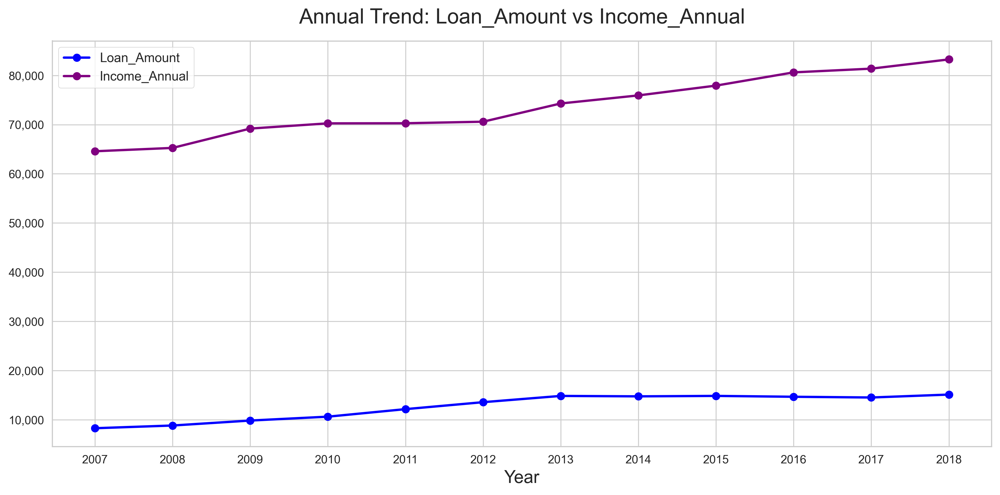

In [21]:
#Line PLot- Loan_Amount vs Income
annual_trend_plot('Loan_Amount', 'Income_Annual')

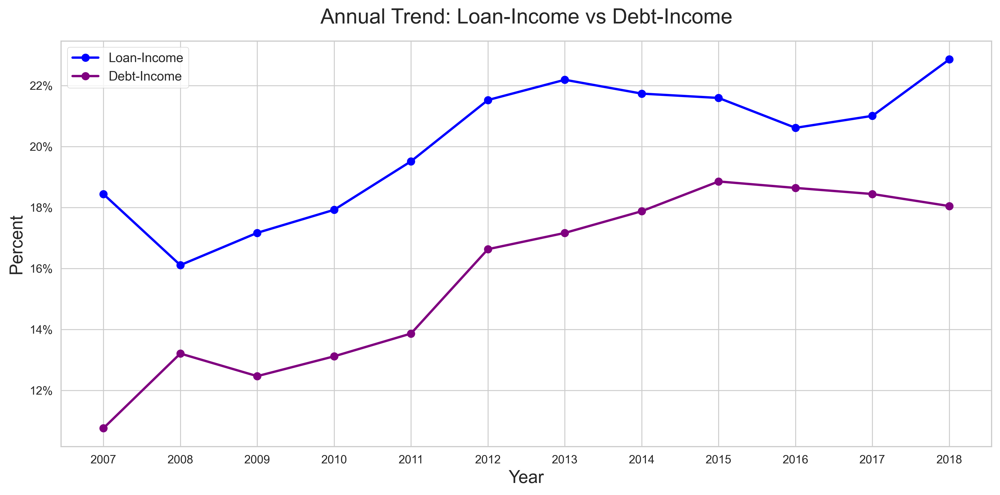

In [22]:
#Line PLot- Loan-Income vs Debt-Income
annual_trend_plot('Loan-Income', 'Debt-Income', y_format='percent', ylabel = 'Percent')

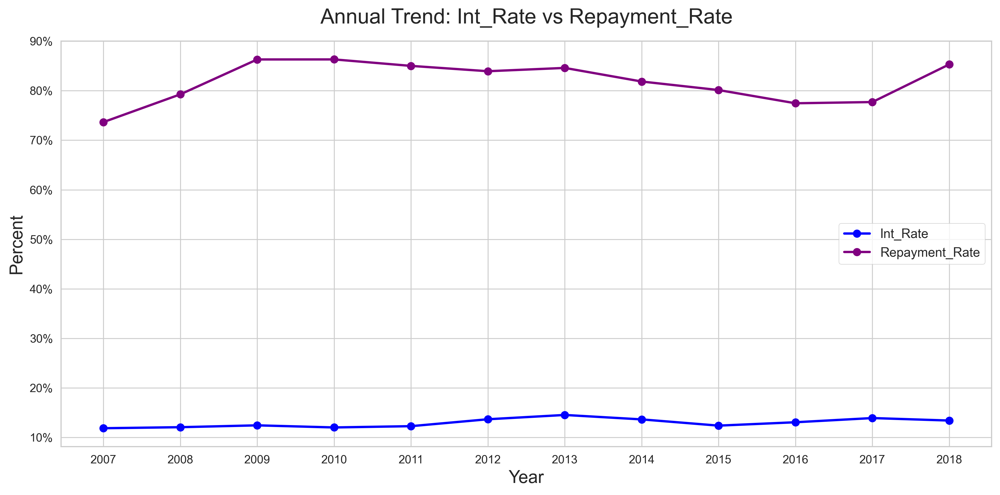

In [23]:
#Line PLot- Interest Rate vs Repayment Rate
annual_trend_plot('Int_Rate', 'Repayment_Rate', y_format='percent', ylabel = 'Percent')

In [24]:
Accepted_Only['Income_Annual'].describe()

count    1,273,808
mean        77,896
std         71,029
min             33
25%         48,000
50%         65,000
75%         92,500
max     10,999,200
Name: Income_Annual, dtype: float64

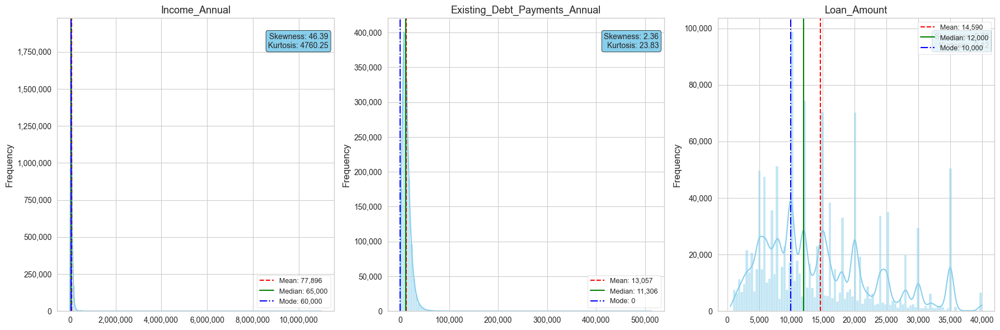

In [25]:
#Histograms- Income, Debt Payments, Loan Amounts
custom_kde_subplots_1x3(Accepted_Only, 'Income_Annual', 'Existing_Debt_Payments_Annual', 'Loan_Amount')

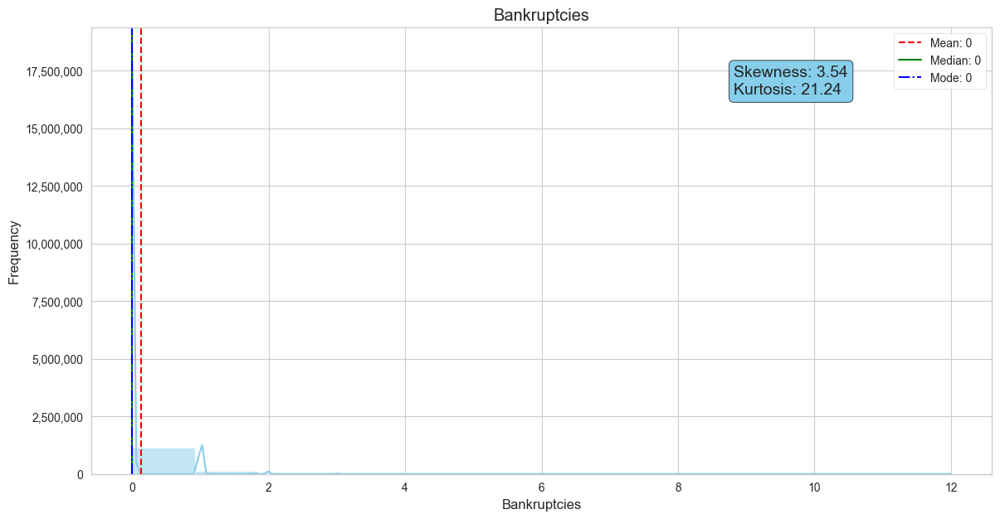

In [12]:
custom_kde(Accepted_Only, 'Bankruptcies', nbins=13)

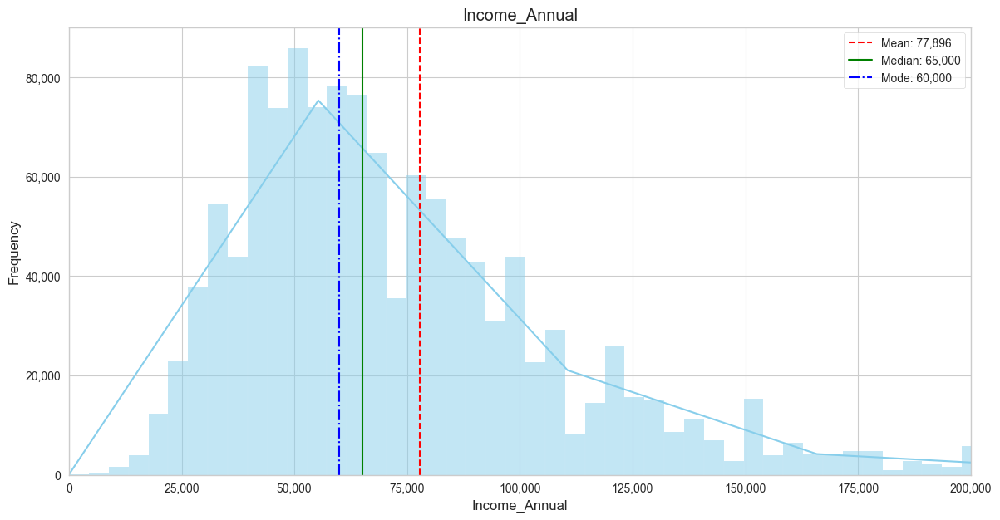

In [26]:
custom_kde(Accepted_Only, 'Income_Annual', 200000, nbins=2500)

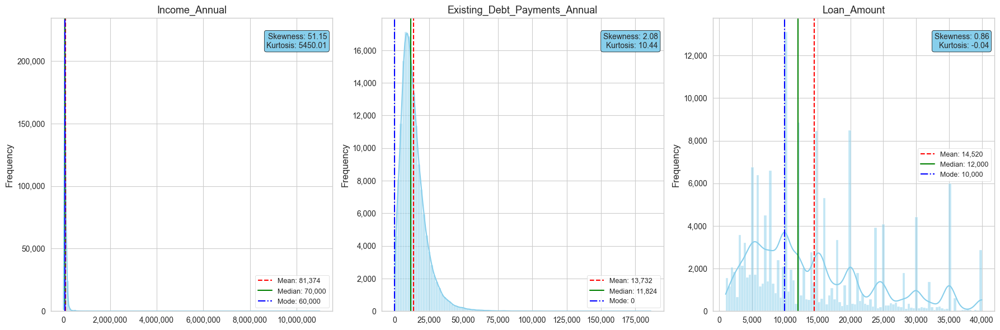

In [27]:
#Histograms- Income, Debt Payments, Loan Amounts (2017 only)
custom_kde_subplots_1x3(Accepted_Only_2017, 'Income_Annual', 'Existing_Debt_Payments_Annual', 'Loan_Amount')

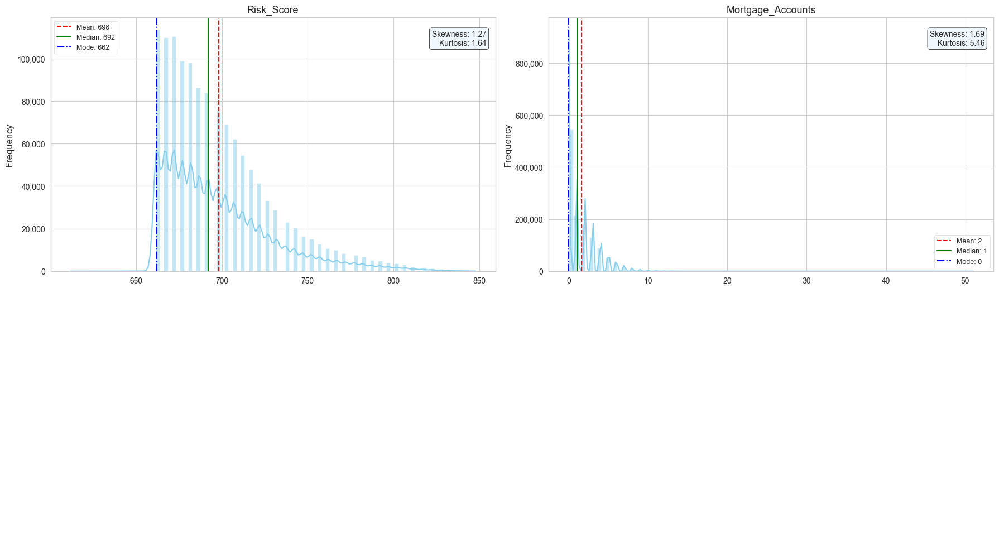

In [28]:
#Histograms- Risk_Score, Mortgage Accounts
custom_kde_subplots_2x2(Accepted_Only, 'Risk_Score', 'Mortgage_Accounts', None, None)

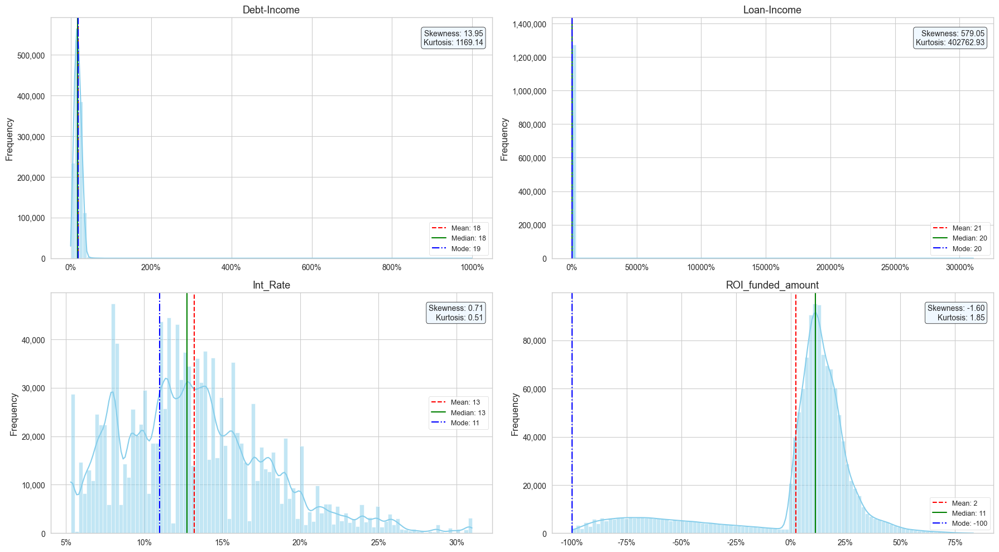

In [29]:
#Histograms: Debt-Income, Loan-Income, Interest Rate, ROI_funded
custom_kde_subplots_2x2(Accepted_Only, 'Debt-Income', 'Loan-Income', 'Int_Rate', 'ROI_funded_amount', x_format='percent')

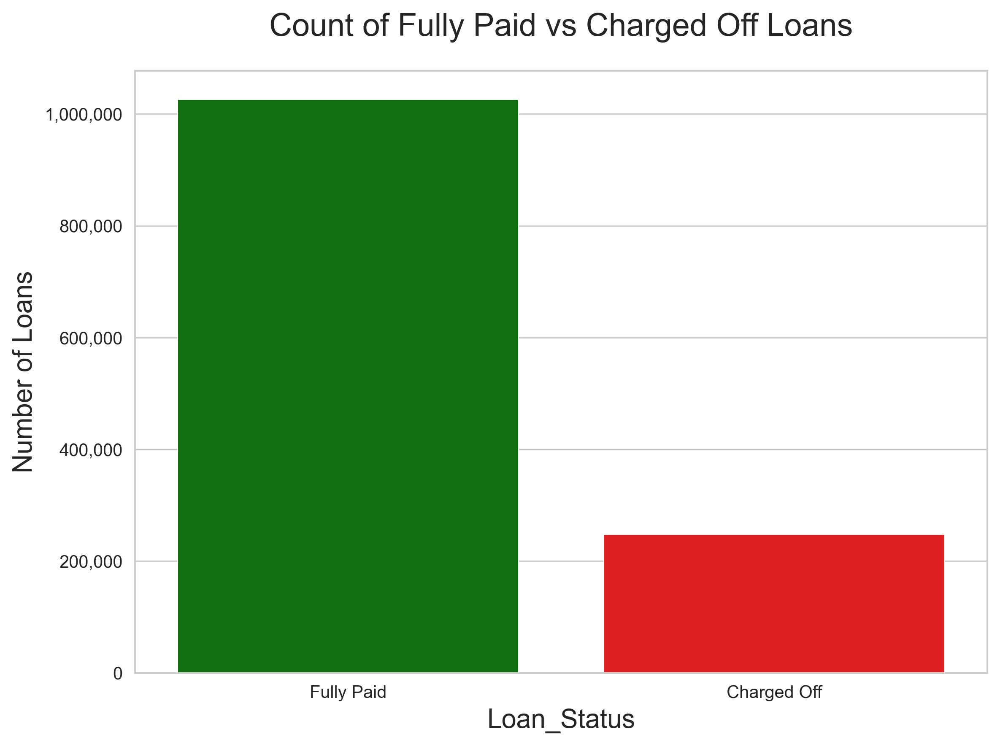

In [30]:
#Barplot- Counts by Loan Status
col = 'Loan_Status'

paid_counts = Accepted_Only.loc[Accepted_Only[col] == 'Fully Paid', col].value_counts().sum()
default_counts = Accepted_Only.loc[Accepted_Only[col] == 'Charged Off', col].value_counts().sum()

combined = pd.DataFrame({
    col: ['Fully Paid', 'Charged Off'],
    'Count': [paid_counts, default_counts]
})

sns.set_style('whitegrid')
plt.figure(figsize=(8, 6), dpi=300)

sns.barplot(
    data=combined,
    x=col,
    y='Count',
    hue=col,
    palette=['green', 'red']
)

plt.title('Count of Fully Paid vs Charged Off Loans', fontsize=18, pad=20)
plt.xlabel(col, fontsize=15)
plt.ylabel('Number of Loans', fontsize=15)
plt.gca().yaxis.set_major_formatter(mtick.FuncFormatter(lambda x, _: f'{int(x):,}'))
plt.tight_layout()
plt.show()

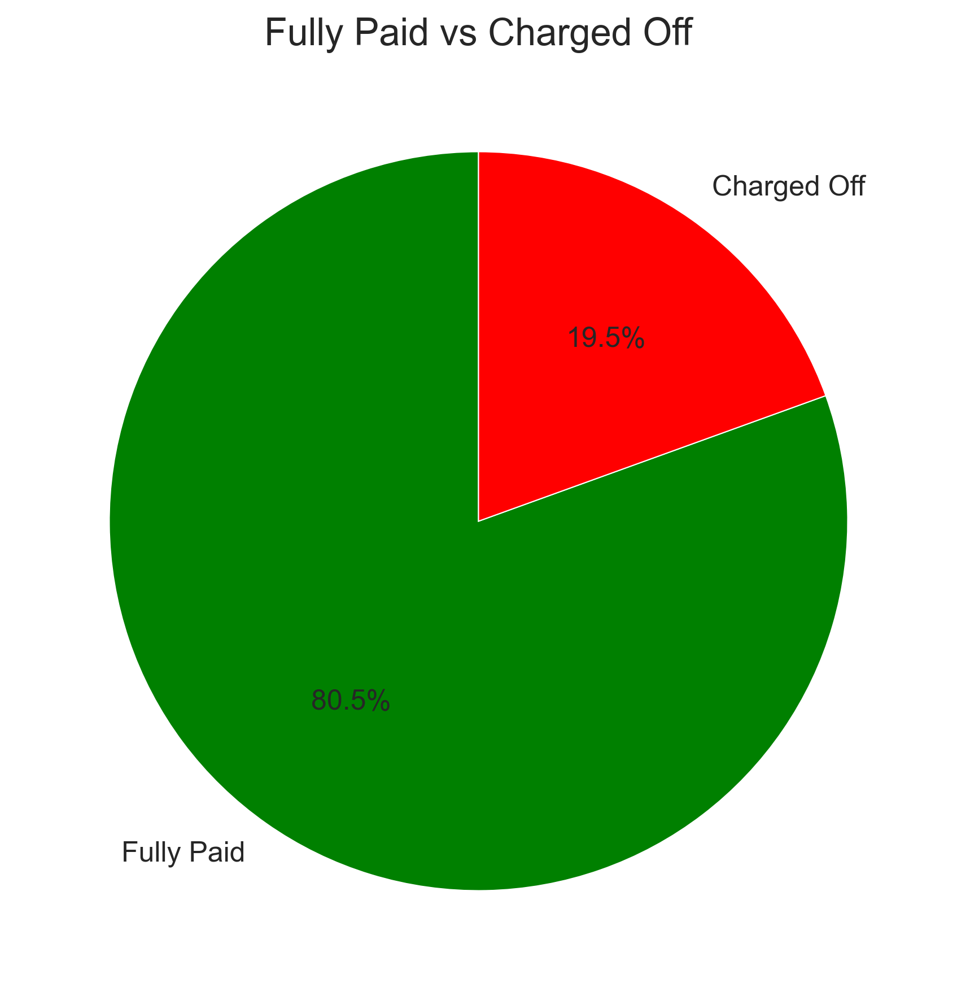

In [17]:
#Pie Chart: Loan Status
status_counts = Accepted_Only['Loan_Status'].value_counts()

plt.figure(figsize=(6, 6), dpi=300)
colors = ['green', 'red']

plt.pie(
    status_counts,
    labels=status_counts.index,
    autopct='%1.1f%%',
    startangle=90,
    colors=colors,
    textprops={'fontsize': 12}
)

plt.title('Fully Paid vs Charged Off', fontsize=16)
plt.tight_layout()
plt.show()

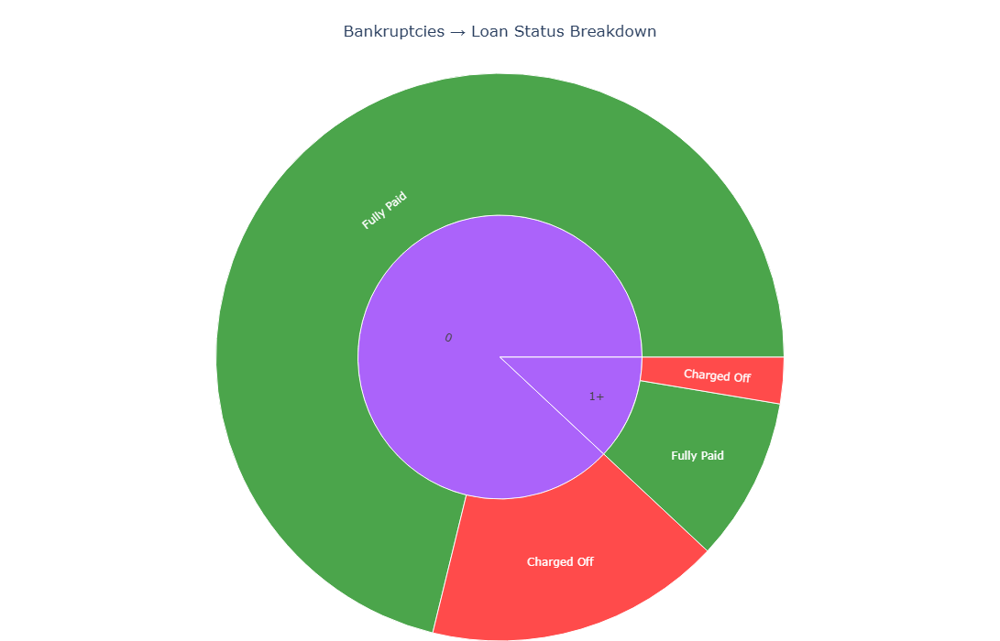

In [27]:
# Prepare grouped counts
sun_df = (
    Accepted_Only_Bankruptcy
    .groupby(['Bankruptcies', 'Loan_Status'])
    .size()
    .reset_index(name='Count')
)

# Create Sunburst
fig = px.sunburst(
    sun_df,
    path=['Bankruptcies', 'Loan_Status'],
    values='Count',
    color='Loan_Status',
    color_discrete_map={
        'Fully Paid': 'green',
        'Charged Off': 'red',
        'Default': 'orange'
    },
    title='Bankruptcies → Loan Status Breakdown'
)

fig.update_traces(
    hovertemplate='<b>%{label}</b><br>' +
                  'Count: %{value:,}<br>' +
                  'Percent of Parent: %{percentParent:.2%}<br>' +
                  'Percent of Total: %{percentRoot:.2%}<br><extra></extra>'
)

fig.update_layout(
    width=700,
    height=700,
    title_x=0.5,
    margin=dict(t=80, l=0, r=0, b=0)
)

fig.show()

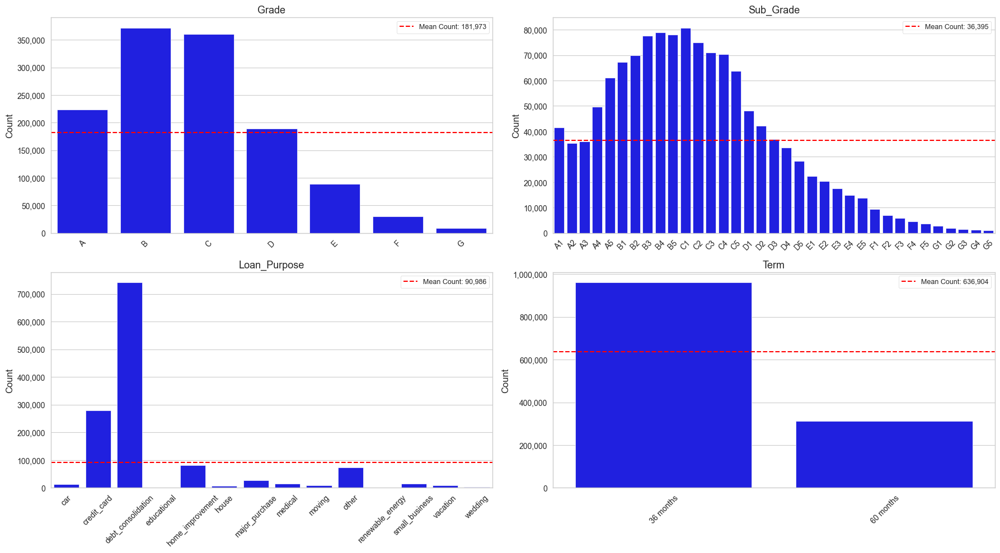

In [32]:
#Bar Plots Distribution- Grade, Sub Grade, Loan Purpose, Term
custom_bar_subplots_2x2(Accepted_Only, 'Grade', 'Sub_Grade', 'Loan_Purpose', 'Term')

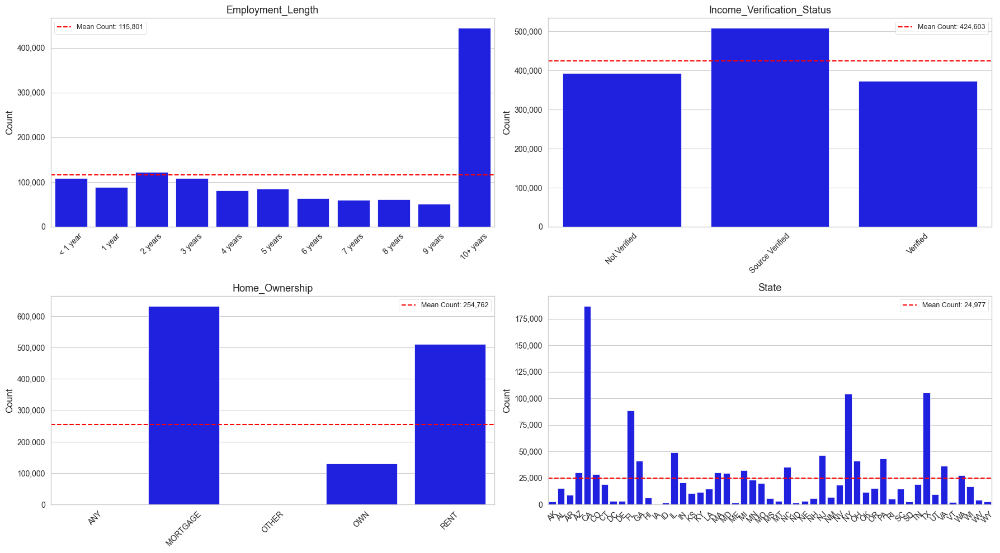

In [33]:
#Bar Plots Distribution- Employment Length, Income Verification, Home Ownership, State
custom_bar_subplots_2x2(Accepted_Only, 'Employment_Length', 'Income_Verification_Status', 'Home_Ownership', 'State')

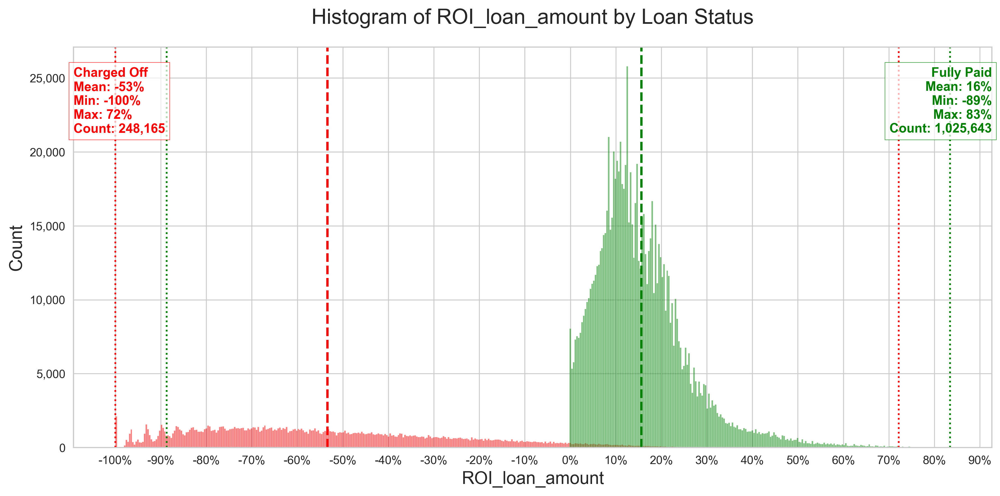

In [34]:
stacked_hist_status('ROI_loan_amount')

In [35]:
#ROI_loan Range of Paid Loans
print('Min ROI:', Accepted_Only_Paid['ROI_loan_amount'].min())
print('Max ROI:', Accepted_Only_Paid['ROI_loan_amount'].max())
Accepted_Only_Paid['ROI_loan_amount'].describe()
#print(Accepted_Only_Paid['ROI'].value_counts(dropna=False).sort_index())

Min ROI: -88.6832
Max ROI: 83.4629


count   1,025,643
mean           16
std            11
min           -89
25%             9
50%            14
75%            20
max            83
Name: ROI_loan_amount, dtype: float64

In [36]:
#ROI_loan Range of Charged Off Loans
print('Min ROI:', Accepted_Only_ChargedOff['ROI_loan_amount'].min())
print('Max ROI:', Accepted_Only_ChargedOff['ROI_loan_amount'].max())
Accepted_Only_ChargedOff['ROI_loan_amount'].describe()
#print(Accepted_Only_ChargedOff['ROI'].value_counts(dropna=False).sort_index())

Min ROI: -100.0
Max ROI: 72.1845882352941


count   248,165
mean        -53
std          28
min        -100
25%         -76
50%         -58
75%         -35
max          72
Name: ROI_loan_amount, dtype: float64

In [37]:
Accepted_Only_Paid['NetPrincipal_LoanAmount'] = Accepted_Only_Paid['Principal_Received'] - Accepted_Only_Paid['Loan_Amount']
Accepted_Only_Paid['NetPrincipal_FundedAmount'] = Accepted_Only_Paid['Principal_Received'] - Accepted_Only_Paid['Funded_Amount']

In [38]:
Accepted_Only_Paid[Accepted_Only_Paid['ROI_loan_amount'] < 0].head()

,Loan_Status,Term,Grade,Sub_Grade,Risk_Score,Employment_Length,Income_Verification_Status,Income_Annual,Existing_Debt_Payments_Annual,Debt-Income,Loan-Income,Int_Rate,ROI_loan_amount,ROI_funded_amount,Loan_Amount,Funded_Amount,Return_Total,Principal_Received,Interest_Received,LateFees_Received,Year,Mortgage_Accounts,Home_Ownership,State,Loan_Purpose,Credit_Policy,Repayment_Rate,NetPrincipal_LoanAmount,NetPrincipal_FundedAmount
865464,Fully Paid,60 months,D,D3,707,6 years,Verified,"40,000","7,788",19,44,17,-24,48,"17,500","8,950","13,227","8,950","4,277",0,2011,0,RENT,CA,small_business,Old,100,"-8,550",0
865473,Fully Paid,60 months,D,D4,687,5 years,Verified,"44,000","8,268",19,48,18,-14,33,"20,975","13,575","18,112","13,575","4,537",0,2011,0,MORTGAGE,GA,credit_card,Old,100,"-7,400",0
865483,Fully Paid,60 months,D,D3,727,3 years,Verified,"150,000","11,265",8,23,17,-17,31,"35,000","22,075","28,887","22,075","6,812",0,2011,0,MORTGAGE,NY,home_improvement,Old,100,"-12,925",0
865499,Fully Paid,60 months,B,B3,742,4 years,Verified,"47,800","4,799",10,42,12,-24,19,"20,000","12,800","15,169","12,800","2,369",0,2011,0,MORTGAGE,VA,debt_consolidation,Old,100,"-7,200",0
865619,Fully Paid,60 months,D,D3,697,10+ years,Verified,"109,000","8,448",8,19,17,-16,49,"21,000","11,800","17,608","11,800","5,808",0,2011,0,MORTGAGE,NJ,debt_consolidation,Old,100,"-9,200",0


In [39]:
#NetPrincipal based on Loan Amount
print('Min:', Accepted_Only_Paid['NetPrincipal_LoanAmount'].min())
print('Max:', Accepted_Only_Paid['NetPrincipal_LoanAmount'].max())
Accepted_Only_Paid['NetPrincipal_LoanAmount'].describe()

Min: -21150.0
Max: 0.25


count   1,025,643
mean           -9
std           266
min       -21,150
25%             0
50%             0
75%             0
max             0
Name: NetPrincipal_LoanAmount, dtype: float64

In [40]:
#NetPrincipal based on Funded Amount
print('Min:', Accepted_Only_Paid['NetPrincipal_FundedAmount'].min())
print('Max:', Accepted_Only_Paid['NetPrincipal_FundedAmount'].max())
Accepted_Only_Paid['NetPrincipal_FundedAmount'].describe()

Min: -1.9699999999993452
Max: 0.25


count   1,025,643
mean           -0
std             0
min            -2
25%             0
50%             0
75%             0
max             0
Name: NetPrincipal_FundedAmount, dtype: float64

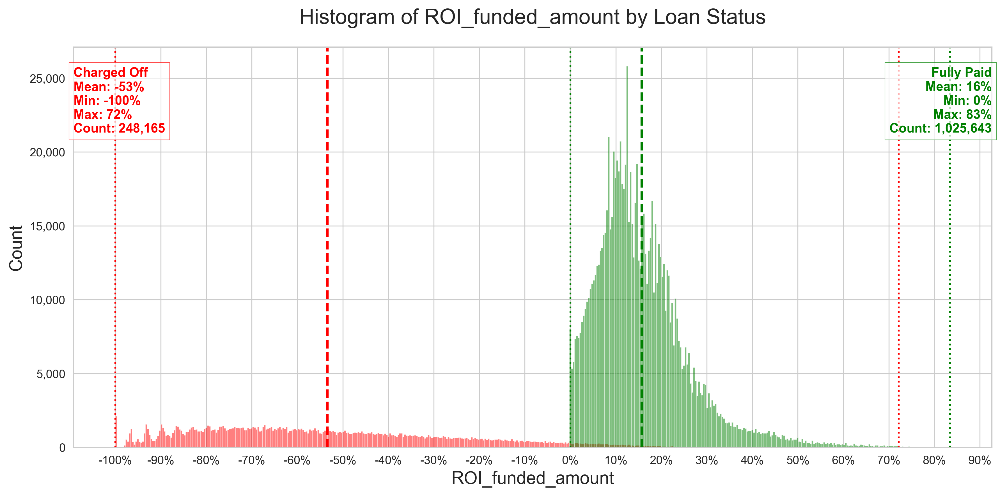

In [41]:
stacked_hist_status('ROI_funded_amount')

In [42]:
print((Accepted_Only['ROI_loan_amount'] - Accepted_Only['ROI_funded_amount']).describe())

count   1,273,808
mean           -0
std             1
min          -122
25%             0
50%             0
75%             0
max             0
dtype: float64


In [43]:
#Charged Off Only Positive ROI
Accepted_Only_ChargedOff.loc[Accepted_Only_ChargedOff['ROI_funded_amount'] > 0].sort_values(by='ROI_funded_amount', ascending=False).head(20)

,Loan_Status,Term,Grade,Sub_Grade,Risk_Score,Employment_Length,Income_Verification_Status,Income_Annual,Existing_Debt_Payments_Annual,Debt-Income,Loan-Income,Int_Rate,ROI_loan_amount,ROI_funded_amount,Loan_Amount,Funded_Amount,Return_Total,Principal_Received,Interest_Received,LateFees_Received,Year,Mortgage_Accounts,Home_Ownership,State,Loan_Purpose,Credit_Policy,Repayment_Rate,Percent_Paid
1045971,Charged Off,60 months,G,G1,672,2 years,Source Verified,"95,000","11,296",12,18,25,72,72,"17,000","17,000","29,271","16,462","12,809",0,2013,5,MORTGAGE,KS,debt_consolidation,Old,0,97
1024915,Charged Off,60 months,F,F5,682,10+ years,Verified,"105,000","15,162",14,16,25,71,71,"16,500","16,500","28,247","15,547","12,700",0,2013,3,MORTGAGE,SC,home_improvement,Old,0,94
958862,Charged Off,60 months,E,E5,662,1 year,Verified,"100,000","27,320",27,35,23,71,71,"35,000","35,000","59,684","34,963","24,721",0,2013,0,RENT,CA,debt_consolidation,New,0,100
970616,Charged Off,60 months,G,G1,662,10+ years,Verified,"85,000","18,420",22,28,26,70,70,"24,000","24,000","40,833","21,853","18,945",36,2013,0,RENT,HI,debt_consolidation,New,0,91
1015195,Charged Off,60 months,F,F4,662,3 years,Verified,"46,000","7,838",17,35,25,70,70,"16,000","16,000","27,178","15,091","12,087",0,2013,0,OWN,TX,credit_card,Old,0,94
965140,Charged Off,60 months,F,F5,672,3 years,Source Verified,"40,000","5,556",14,32,26,70,70,"12,875","12,875","21,863","11,667","10,119",76,2013,0,RENT,NY,other,New,0,91
996085,Charged Off,60 months,F,F5,662,7 years,Source Verified,"90,000","10,539",12,27,26,69,69,"24,000","24,000","40,647","21,932","18,679",36,2013,0,MORTGAGE,LA,debt_consolidation,Old,0,91
1042400,Charged Off,60 months,E,E5,682,6 years,Verified,"70,000","13,783",20,30,22,68,68,"21,000","21,000","35,338","20,933","14,258",146,2013,0,OWN,OK,debt_consolidation,Old,0,100
1018312,Charged Off,60 months,F,F4,672,10+ years,Verified,"55,000","8,222",15,27,25,67,67,"15,000","15,000","25,090","13,667","11,423",0,2013,3,MORTGAGE,OH,debt_consolidation,Old,0,91
998839,Charged Off,60 months,G,G2,687,< 1 year,Source Verified,"85,000","12,291",14,40,26,67,67,"33,950","33,950","56,783","29,910","26,822",51,2013,0,RENT,VA,small_business,Old,0,88


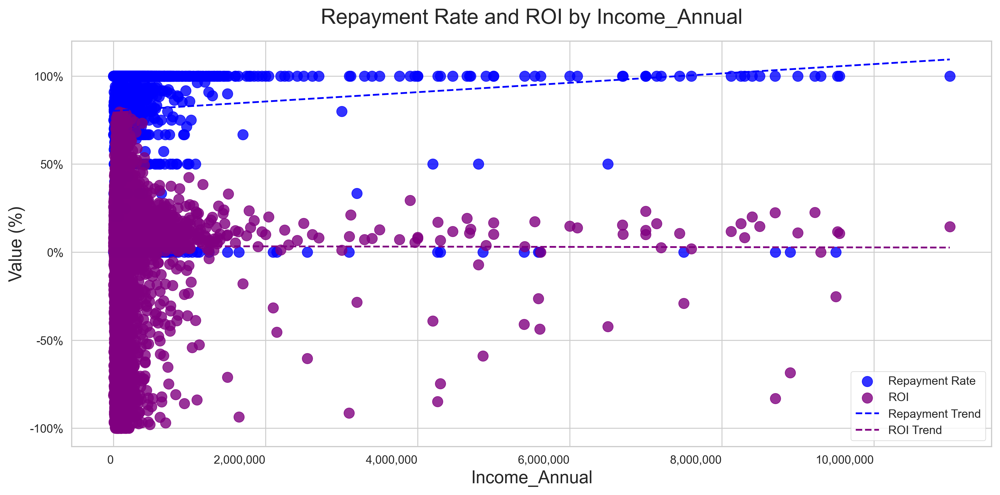

In [44]:
#Income_Annual vs ROI & Repayment Rate
Repayment_ROI_scatter_plot_reg('Income_Annual')

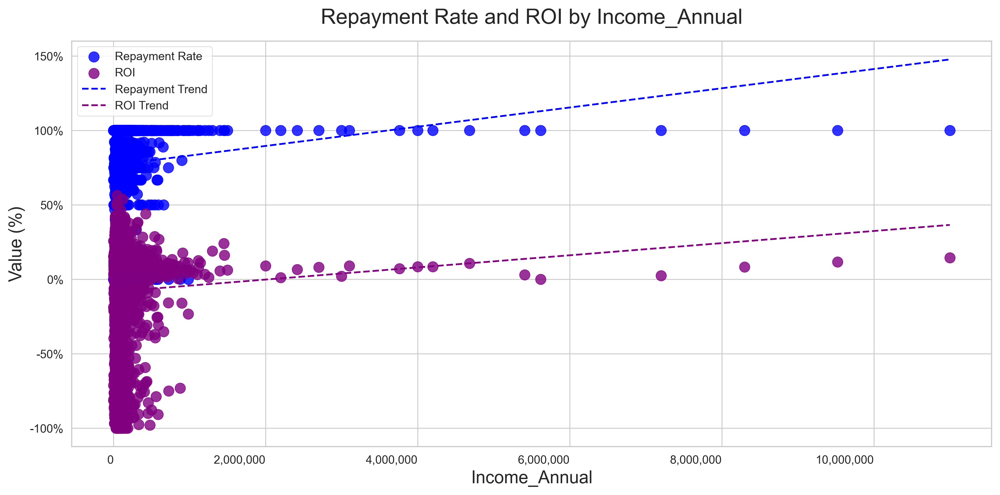

In [45]:
#Income_Annual vs ROI & Repayment Rate (2017 only)
Repayment_ROI_scatter_plot_reg('Income_Annual', df=Accepted_Only_2017)

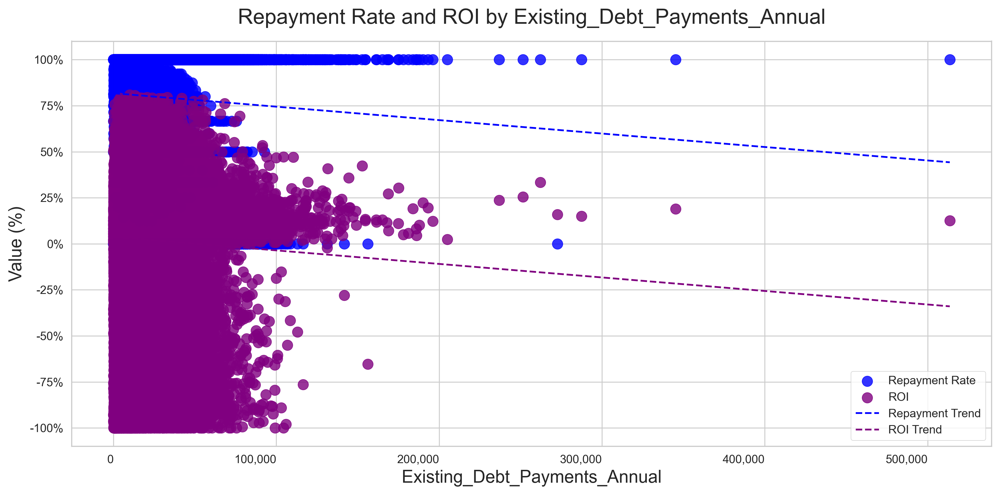

In [46]:
#Existing_Debt_Payments_Annual vs ROI & Repayment Rate
Repayment_ROI_scatter_plot_reg('Existing_Debt_Payments_Annual')

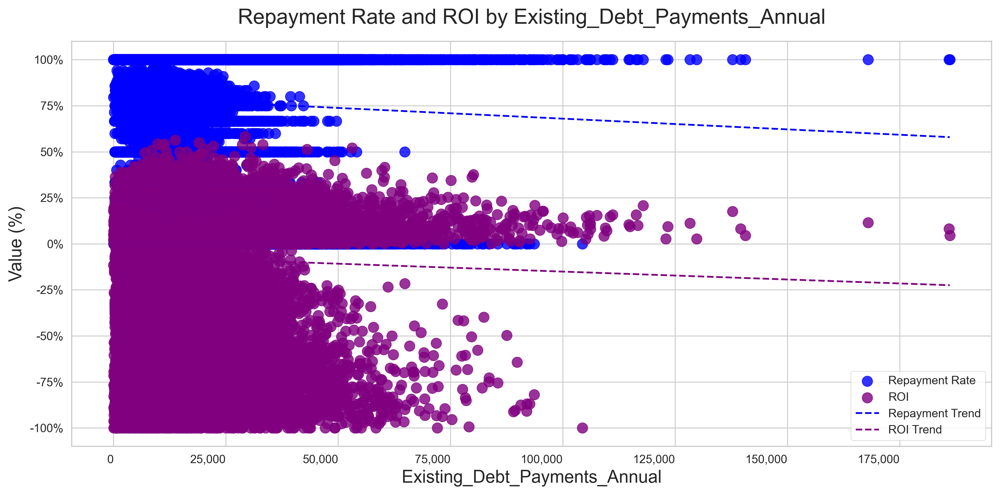

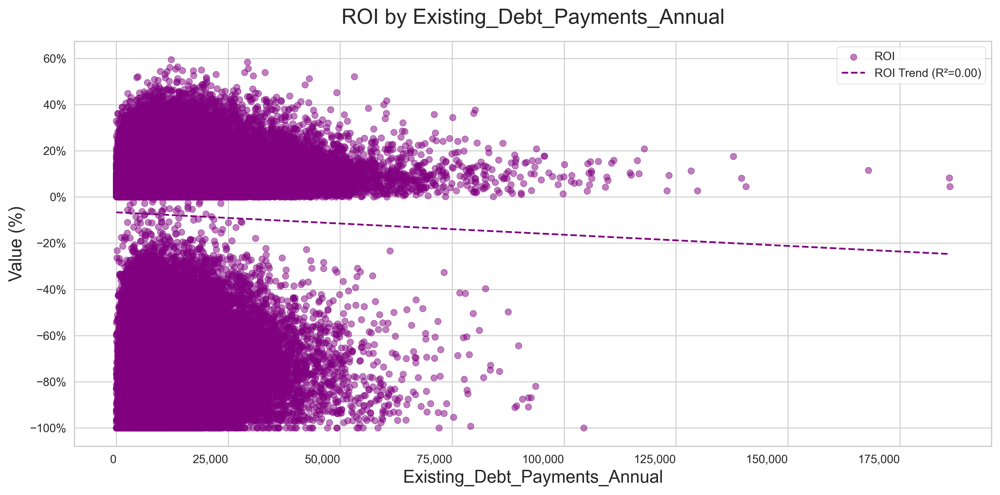

In [47]:
#Existing_Debt_Payments_Annual vs ROI & Repayment Rate (2017 only)
Repayment_ROI_scatter_plot_reg('Existing_Debt_Payments_Annual', df=Accepted_Only_2017)
ROI_scatter_plot_reg('Existing_Debt_Payments_Annual', df=Accepted_Only_2017)

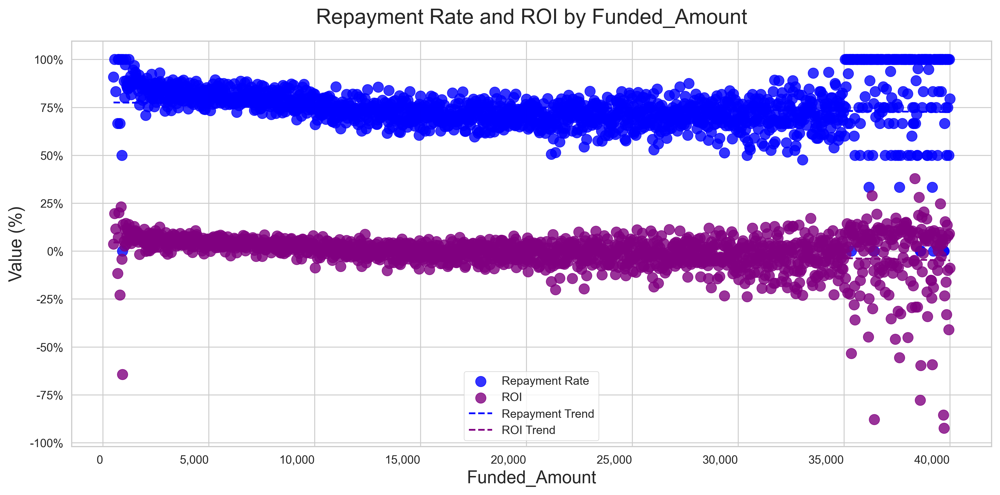

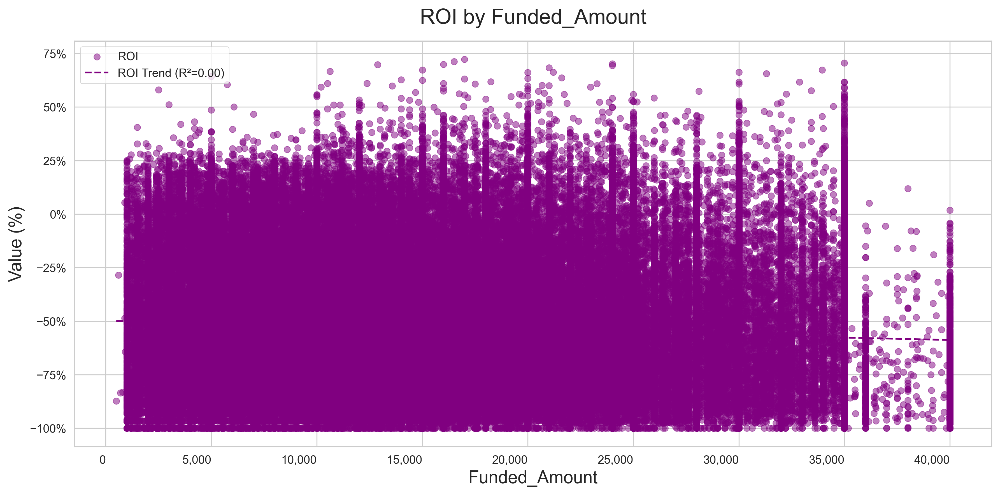

In [48]:
#Funded_Amount vs ROI & Repayment Rate
Repayment_ROI_scatter_plot_reg('Funded_Amount')
ROI_scatter_plot_reg('Funded_Amount')

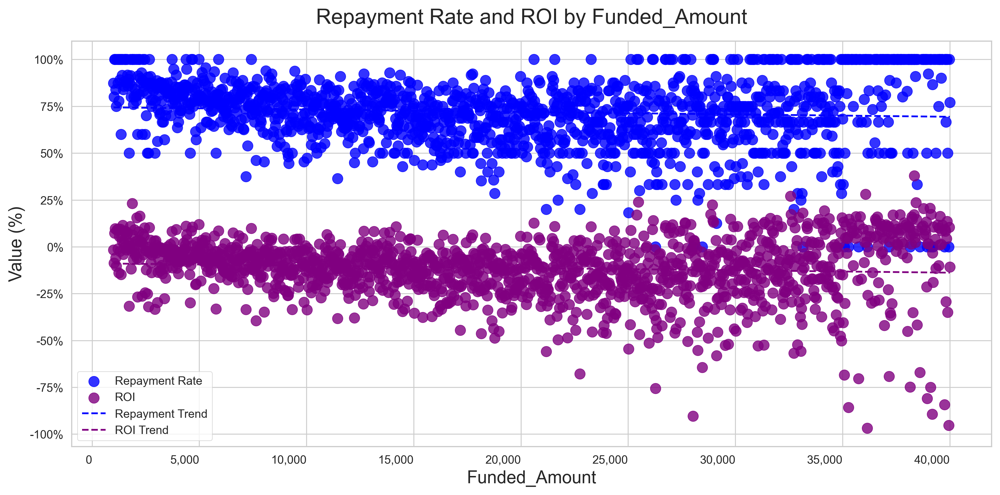

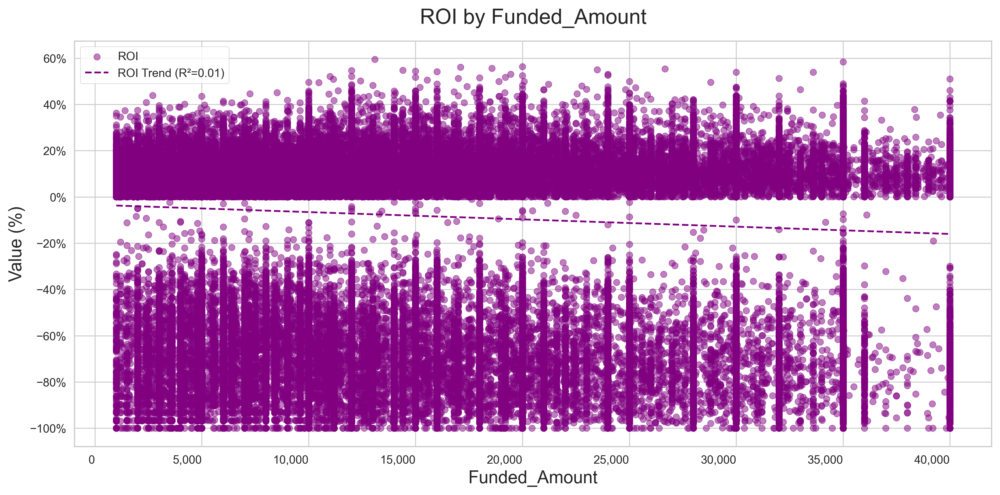

In [49]:
#Funded_Amount vs ROI & Repayment Rate (2017 only)
Repayment_ROI_scatter_plot_reg('Funded_Amount', df=Accepted_Only_2017)
ROI_scatter_plot_reg('Funded_Amount', df=Accepted_Only_2017)

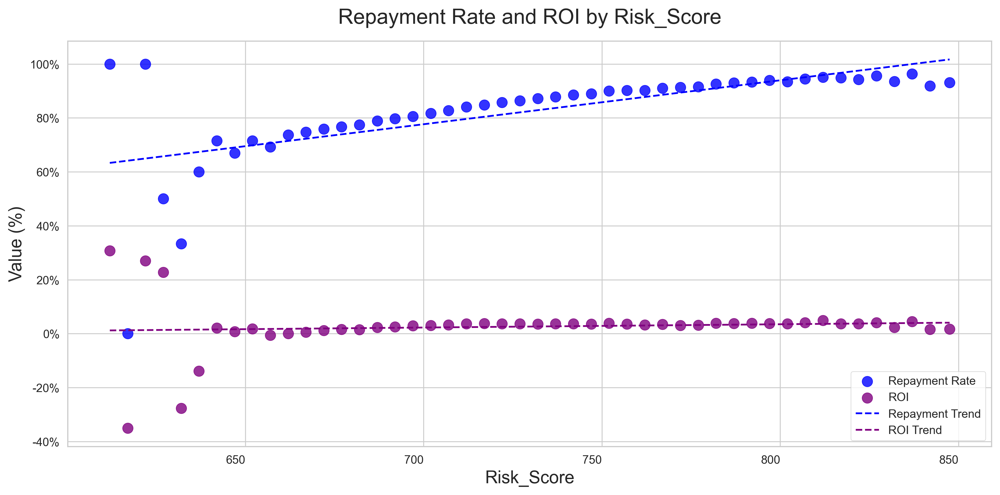

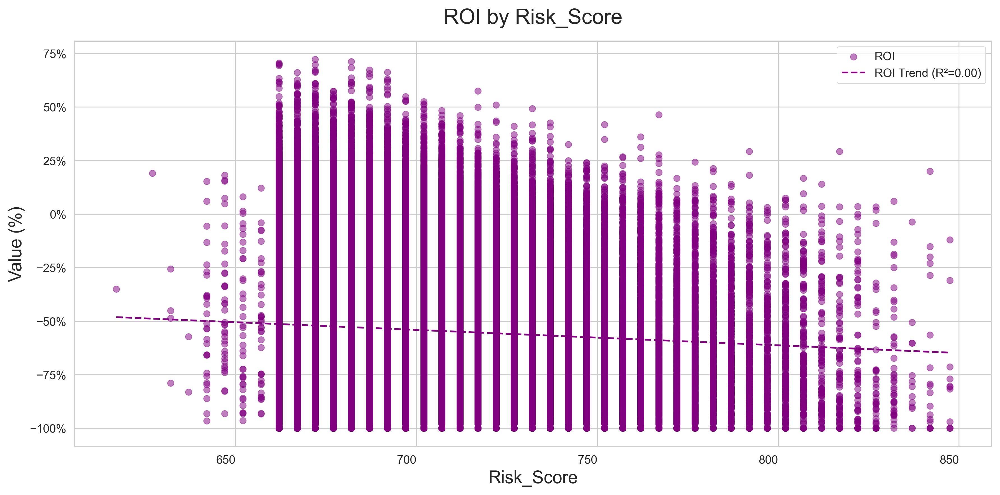

In [50]:
#Risk_Score vs ROI & Repayment Rate
Repayment_ROI_scatter_plot_reg('Risk_Score')
ROI_scatter_plot_reg('Risk_Score')

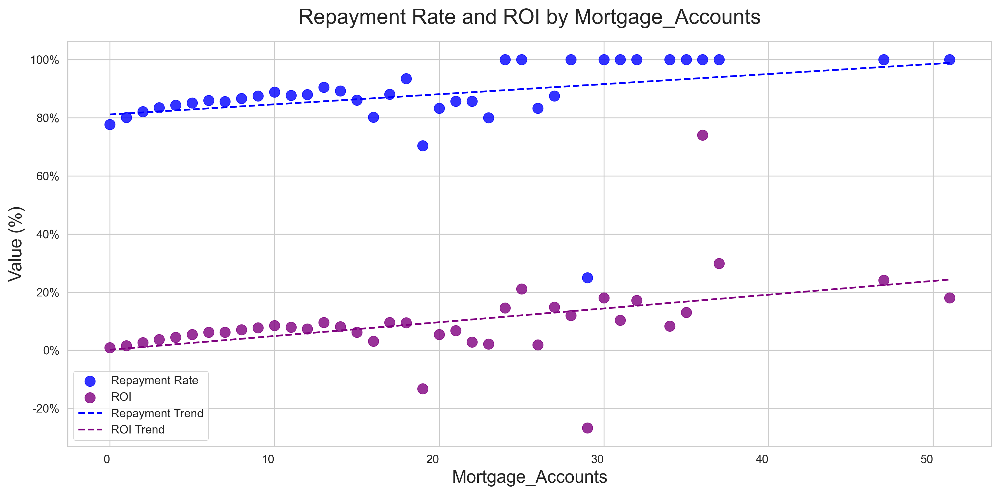

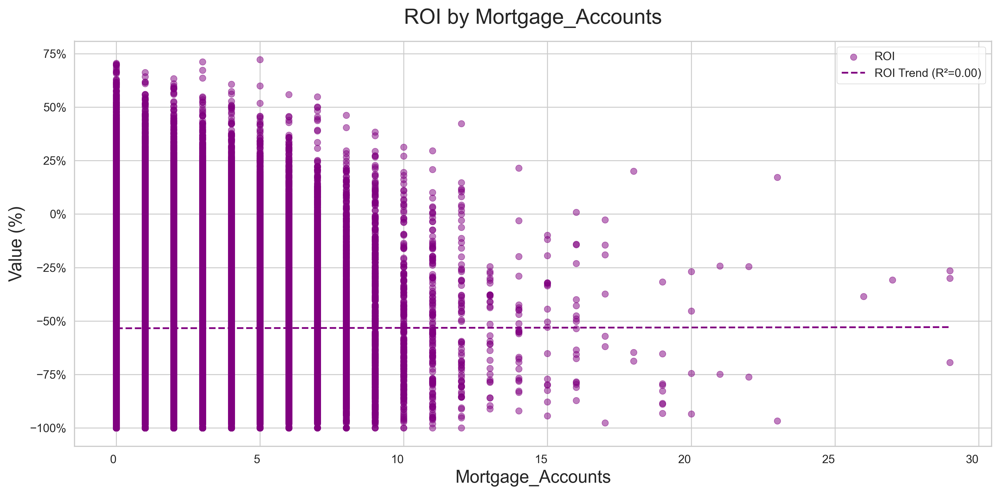

In [51]:
#Mortgage_Accounts vs ROI & Repayment Rate
Repayment_ROI_scatter_plot_reg('Mortgage_Accounts')
ROI_scatter_plot_reg('Mortgage_Accounts')

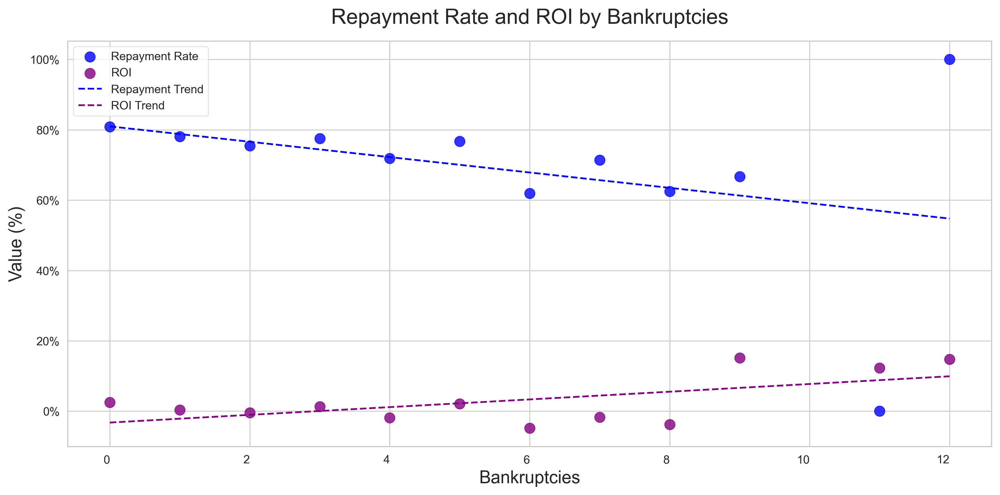

In [16]:
#Debt-Income vs ROI & Repayment Rate
Repayment_ROI_scatter_plot_reg('Bankruptcies', x_format='number')

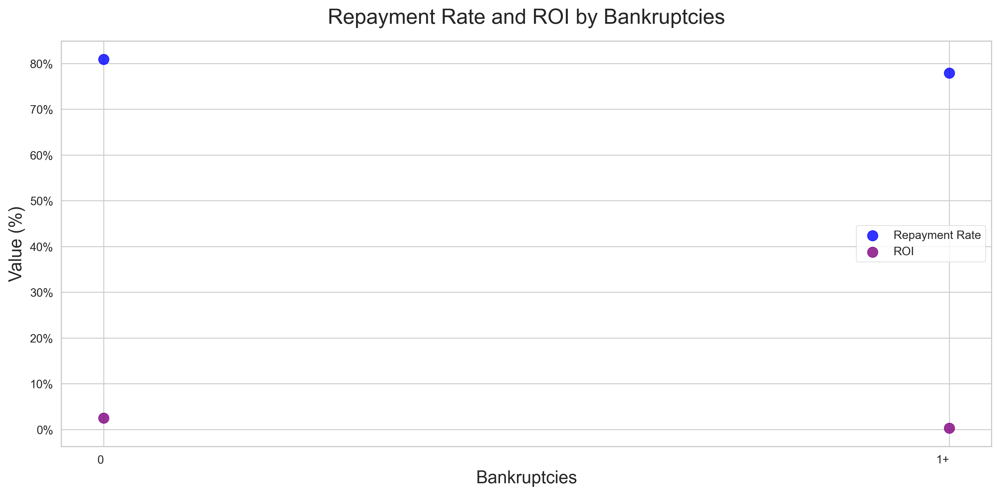

In [22]:
Repayment_ROI_scatter_plot_reg('Bankruptcies', x_format='number', df=Accepted_Only_Bankruptcy)

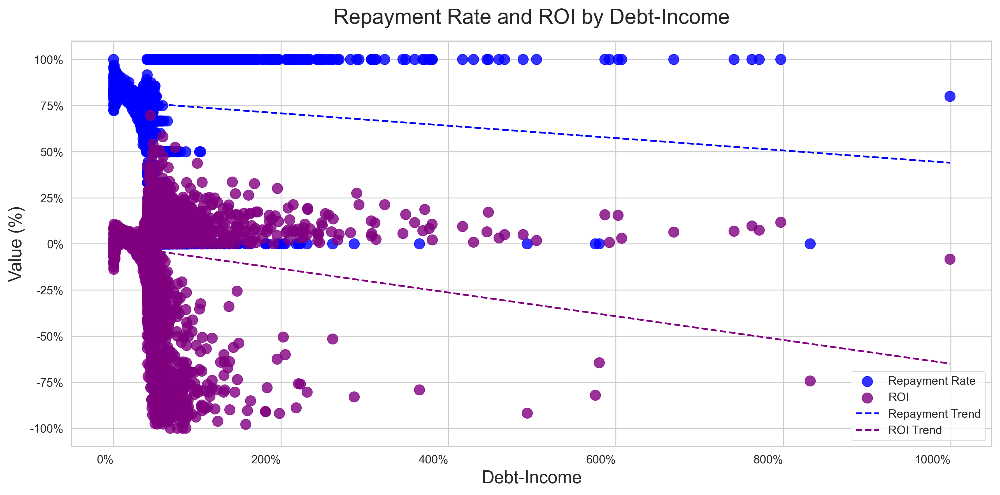

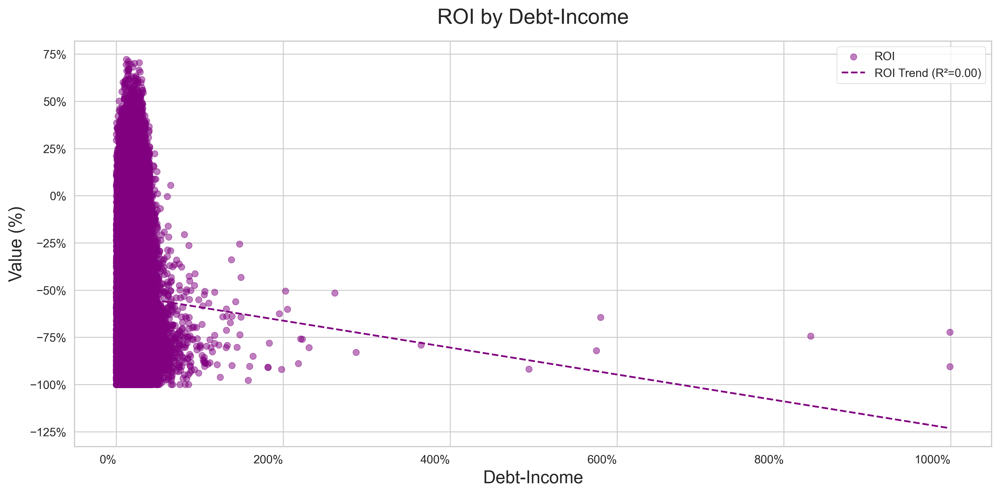

In [52]:
#Debt-Income vs ROI & Repayment Rate
Repayment_ROI_scatter_plot_reg('Debt-Income', x_format='percent')
ROI_scatter_plot_reg('Debt-Income', x_format='percent')

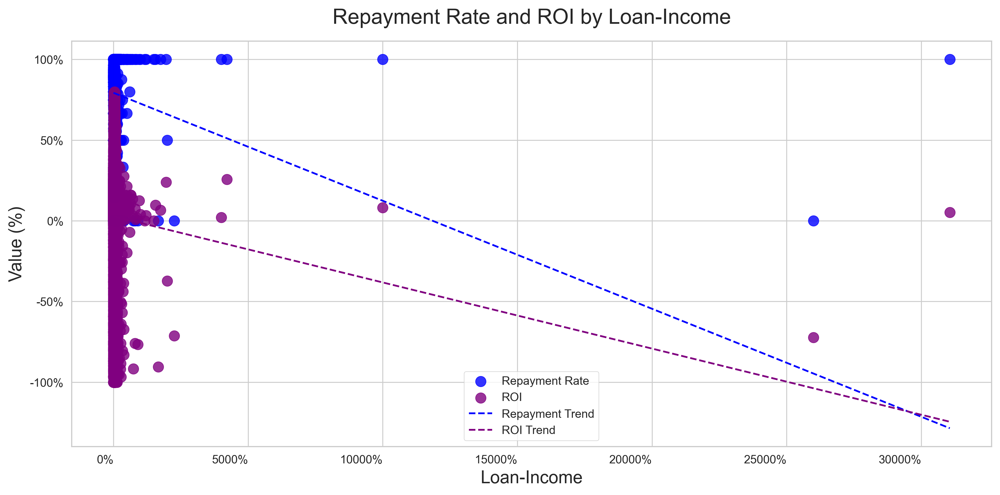

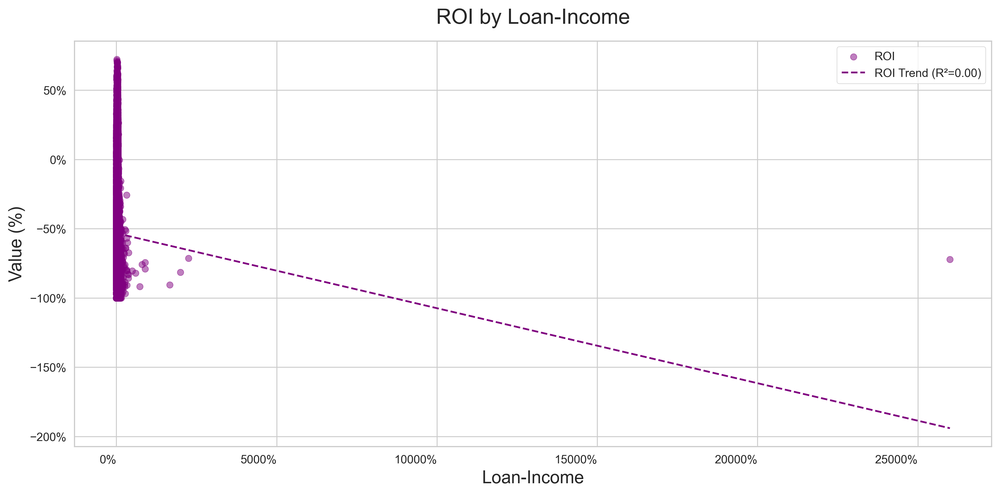

In [53]:
#Loan-Income vs ROI & Repayment Rate
Repayment_ROI_scatter_plot_reg('Loan-Income', x_format='percent')
ROI_scatter_plot_reg('Loan-Income', x_format='percent')

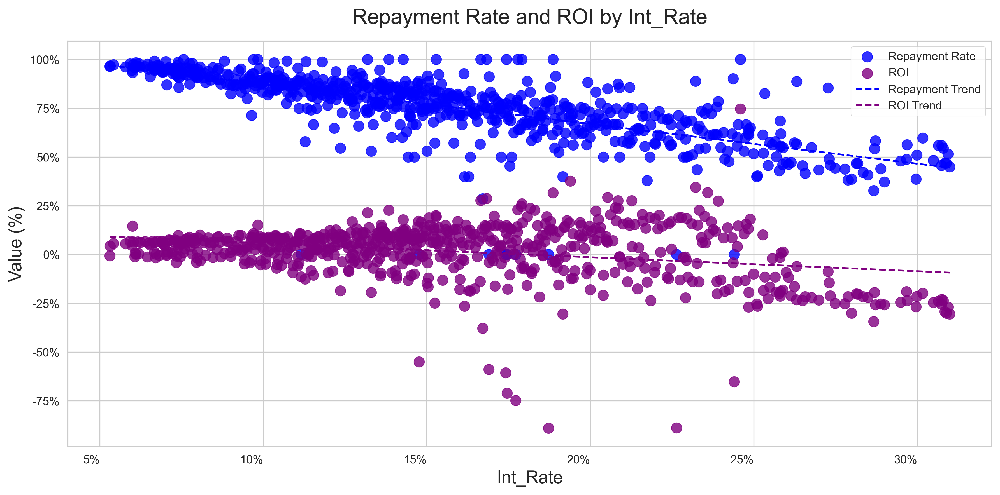

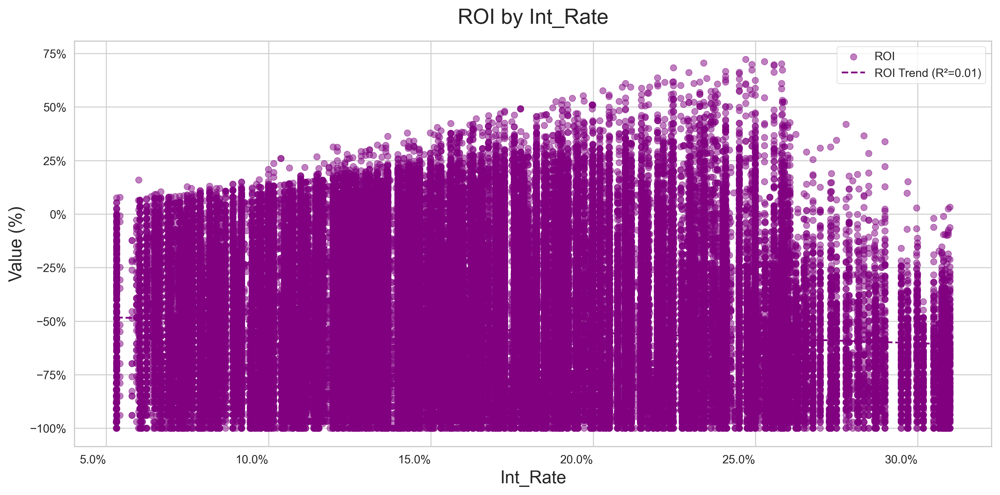

In [54]:
#Int_Rate vs ROI & Repayment Rate
Repayment_ROI_scatter_plot_reg('Int_Rate', x_format='percent')
ROI_scatter_plot_reg('Int_Rate', x_format='percent')

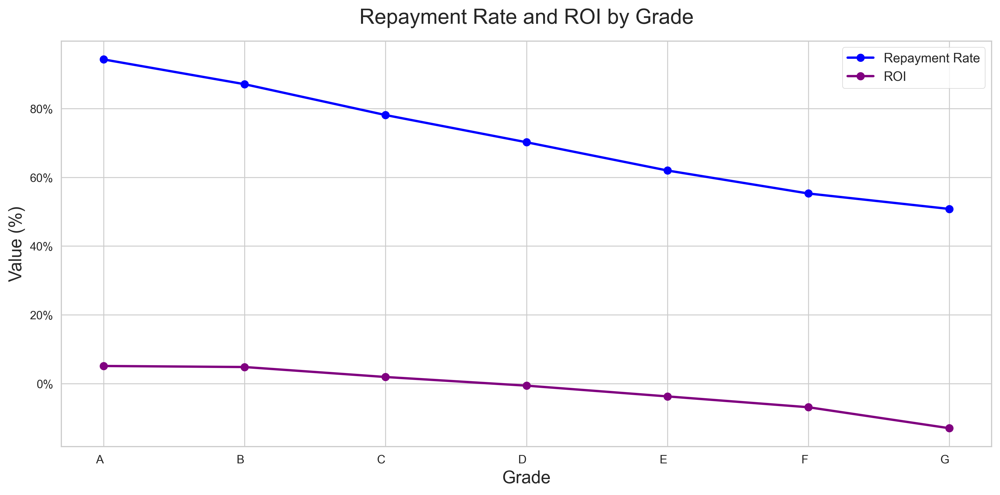

In [55]:
#Grade vs ROI & Repayment Rate
Repayment_ROI_trend_plot('Grade')

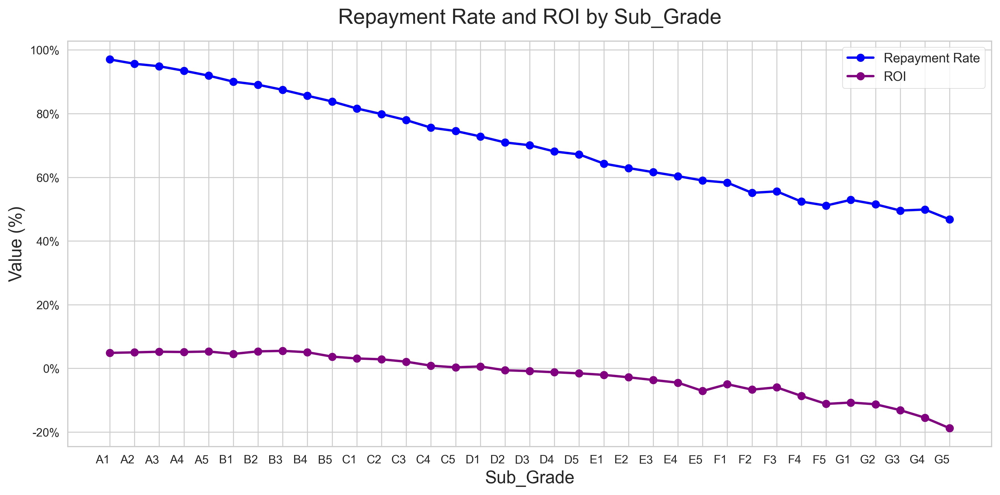

In [56]:
#Sub_Grade vs ROI & Repayment Rate
Repayment_ROI_trend_plot('Sub_Grade')

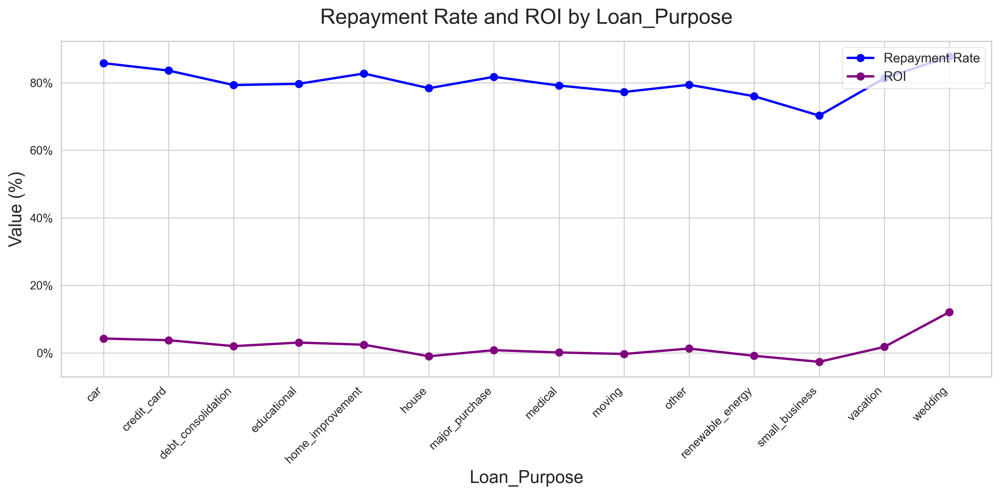

In [57]:
#Loan_Purpose vs ROI & Repayment Rate
Repayment_ROI_trend_plot('Loan_Purpose', rot=45)

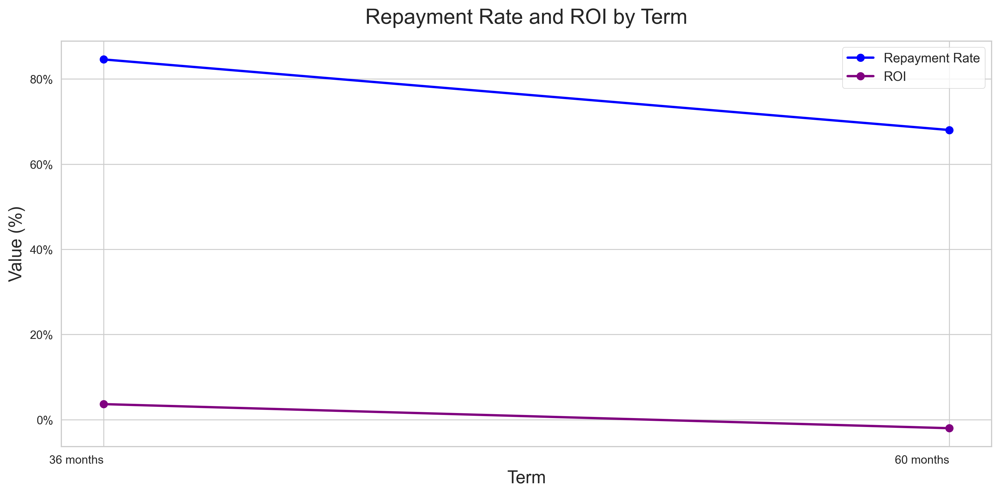

In [58]:
#Term vs ROI & Repayment Rate
Repayment_ROI_trend_plot('Term')

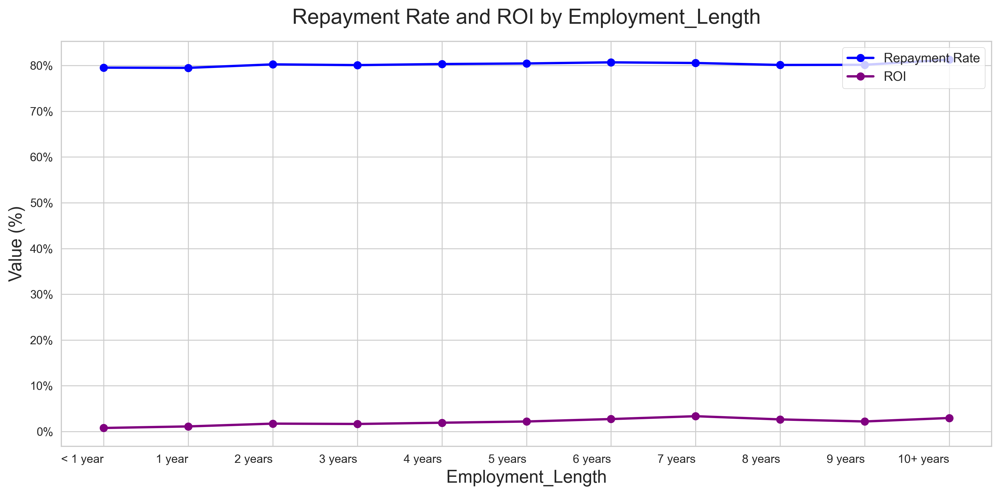

In [59]:
#Employment_Length vs ROI & Repayment Rate
Repayment_ROI_trend_plot('Employment_Length', order = emp_length_order)

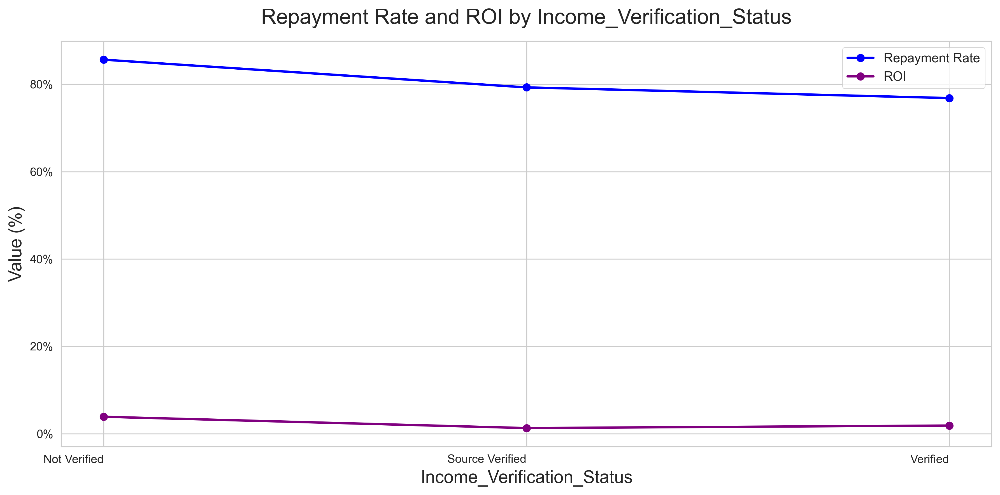

In [60]:
#Income_Verification_Status vs ROI & Repayment Rate
Repayment_ROI_trend_plot('Income_Verification_Status')

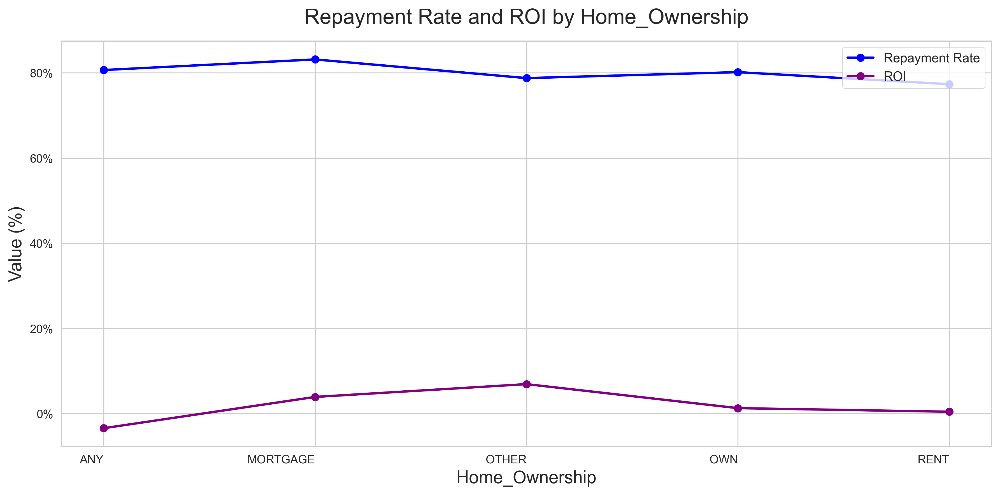

In [61]:
#Home_Ownership vs ROI & Repayment Rate
Repayment_ROI_trend_plot('Home_Ownership')

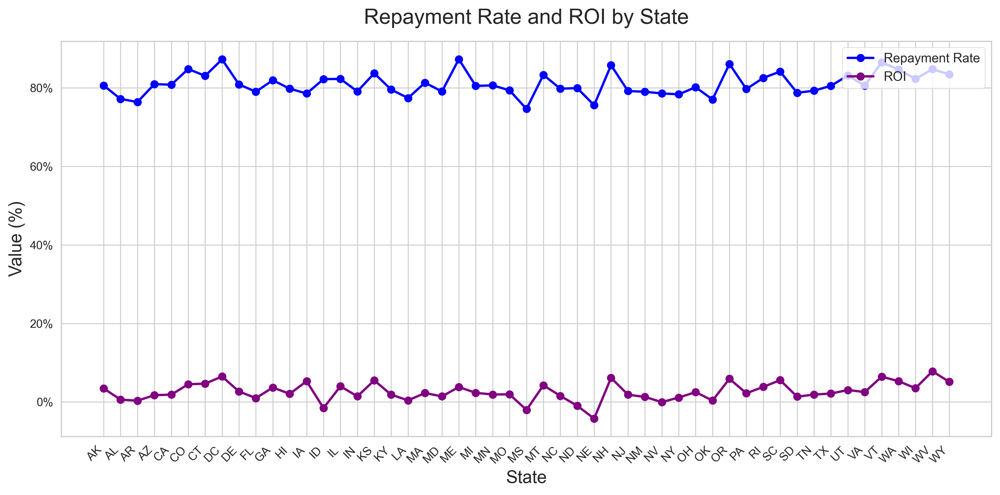

In [62]:
#State vs ROI & Repayment Rate
Repayment_ROI_trend_plot('State', rot=45)

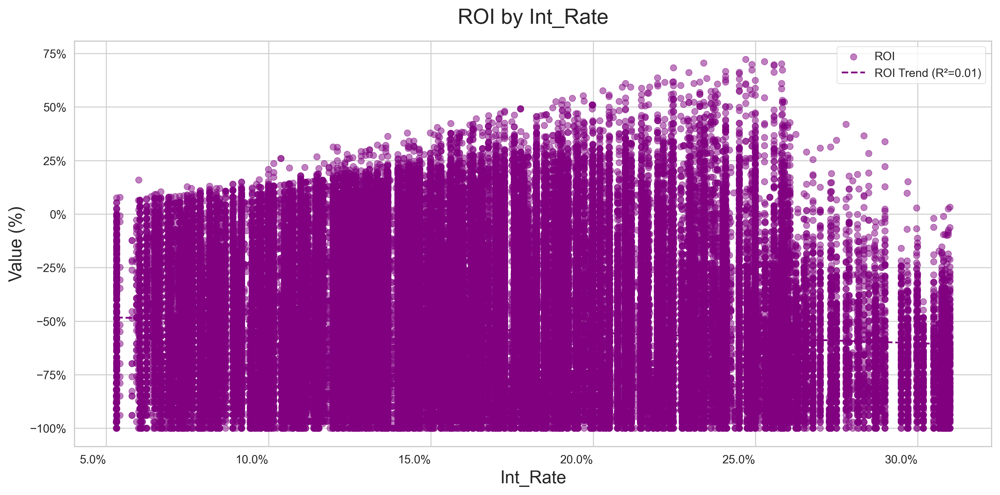

In [63]:
#Percent Paid vs ROI
ROI_scatter_plot_reg('Int_Rate', x_format='percent', df=Accepted_Only_ChargedOff)

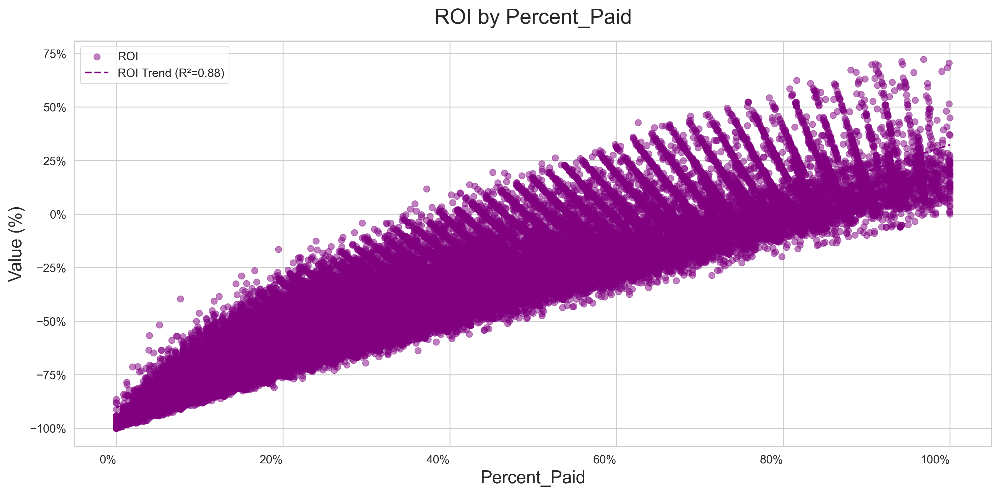

In [64]:
#Percent Paid vs ROI
ROI_scatter_plot_reg('Percent_Paid', x_format='percent', df=Accepted_Only_ChargedOff)

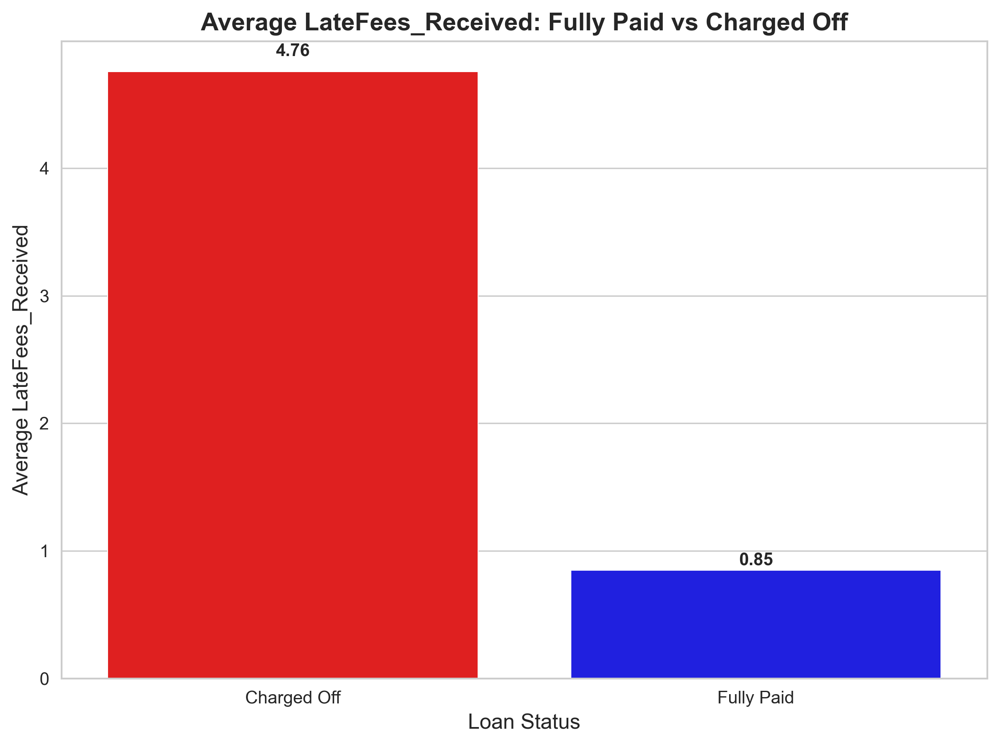

In [65]:
barplot_Paid_Unpaid('LateFees_Received')

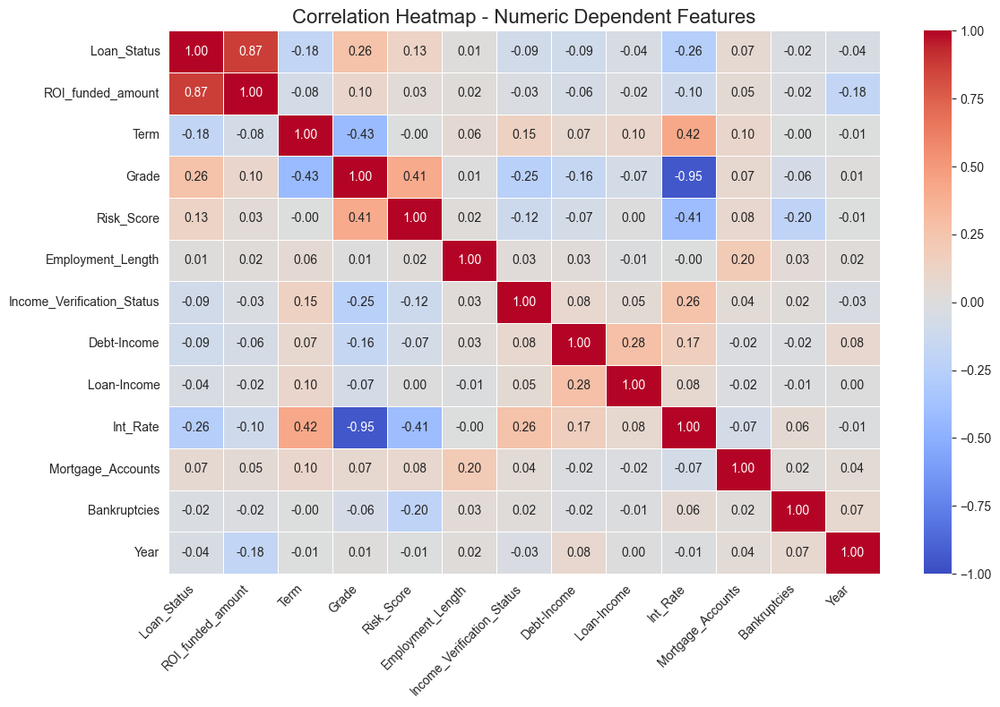

In [24]:
#Heatmap - Numeric Features
plt.figure(figsize=(12, 8))
correlation_matrix = Accepted_Only_Ord_Numeric_only.corr(numeric_only=True)

# Generate Heat Map
heatmap = sns.heatmap(
    correlation_matrix,
    annot=True,
    cmap='coolwarm',
    linewidths=0.5,
    fmt='.2f',
    vmin=-1,
    vmax=1
)

heatmap.set_xticklabels(heatmap.get_xticklabels(), rotation=45, ha='right')

plt.title('Correlation Heatmap - Numeric Dependent Features', fontsize=16)
plt.tight_layout()
plt.show()